In [1]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [6]:
import sys
sys.path.append("..")
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

from typing import Optional
from copy import deepcopy
import matplotlib.pyplot as plt
import numpy as np

from coordination.model.real.vocalic_2d import VocalicModel
from coordination.model.config_bundle.vocalic import Vocalic2DConfigBundle
from coordination.module.coordination.sigmoid_gaussian_coordination import SigmoidGaussianCoordinationSamples
from coordination.model.model import ModelSamples
from coordination.common.normalization import (normalize_serialized_data_per_feature,
                                               normalize_serialized_data_per_subject_and_feature)
from coordination.inference.inference_data import InferenceData

In [23]:
# Functions
def plot_state_space(samples: ModelSamples):
    subject_indices = samples.component_group_samples["state_space"].subject_indices[0]
    values = samples.component_group_samples["state_space"].values[0]
    fig, axs = plt.subplots(1, 2, figsize=(15,4))	
    for subject in range(3):
        ts = np.array([t for t, s in enumerate(subject_indices) if s == subject])
        ys = values[:, ts]
        axs[0].plot(ts, ys[0], label=f"Subject {subject + 1}", marker="o")
        axs[1].plot(ts, ys[1], label=f"Subject {subject + 1}", marker="o")

    axs[0].set_title("Position")
    axs[1].set_title("Speed")
    plt.legend()
    plt.tight_layout()

def plot_observations(samples: ModelSamples):
    subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
    values = samples.component_group_samples["speech_vocalics"].values[0]
    fig, axs = plt.subplots(2, 2, figsize=(15,8))	
    axs = axs.flatten()
    for i, feature_name in enumerate(["pitch", "intensity", "jitter", "shimmer"]):
        for subject in range(3):
            ts = np.array([t for t, s in enumerate(subject_indices) if s == subject])
            ys = values[:, ts]
            axs[i].plot(ts, ys[i], label=f"Subject {subject + 1}", marker="o")
            axs[i].set_title(feature_name)
    plt.legend()
    plt.tight_layout()   

def configure_bundle(num_time_steps: int, coordination: float, noise: float) -> Vocalic2DConfigBundle:
    bundle = Vocalic2DConfigBundle()
    bundle.num_time_steps_in_coordination_scale = num_time_steps
    bundle.sd_a = noise
    bundle.sd_o = noise
    bundle.weights = [np.array([[1, 5, 10, 15]])] # different scale per feature
    bundle.mean_a0 = np.array([[0,1], [25,5], [50,10]])  # Start at different positions and with different speeds
    bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1, num_time_steps)) * coordination)
    bundle.observation_normalization = "norm_per_feature"
    return bundle

def update_config_bundle_from_samples(config_bundle: Vocalic2DConfigBundle, samples: ModelSamples):
    config_bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
    config_bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
    config_bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
    config_bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
    config_bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]

def train(model: VocalicModel, burn_in: int = 2000) -> InferenceData:
    model.prepare_for_inference()    
    idata = model.fit(burn_in = burn_in)
    idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1), marker=None)
    idata.plot_parameter_posterior()
    print(idata.generate_convergence_summary())
    return idata

# Sampling

## Coordination = 0

In the abcensse of coordination, each subject's component follows it's own dynamics which consists of a constant speed and position governed by a simple movement equation. See, for instance, that the position of the component from subject 3 increases faster than the others given its larger speed.

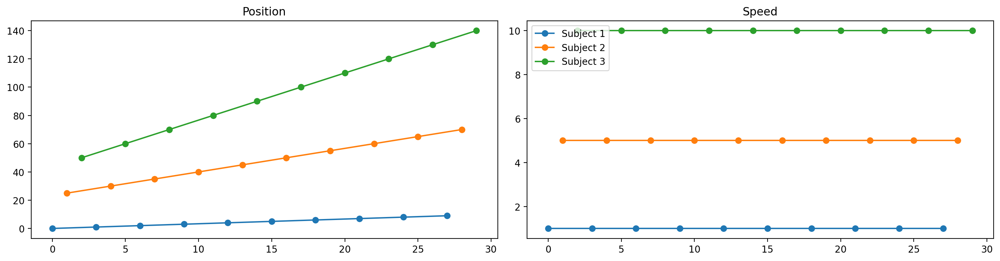

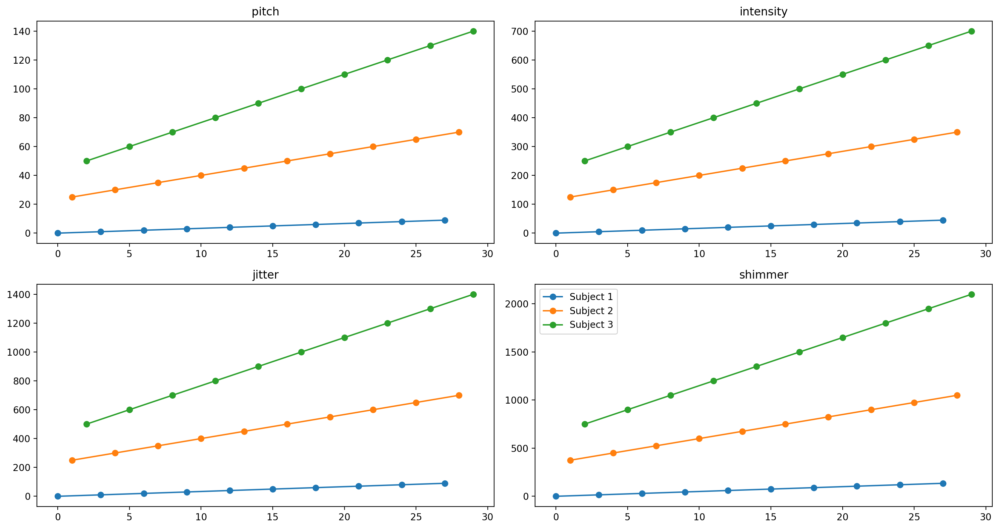

In [10]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0,
    noise=0
)
model = VocalicModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

## Coordination = 1

When coordination is maximum, the components instantly share the same speed which is a positive number in this example, leading to a constant increase in their position over time. Notice, however, that because we do not blend position, each component moves in its own scale, which would be equivalent to different people having different baselines for their biological signals. For instance, person A may have a natural lower picth than person B. Coordination will unlikely make person B to adopt person's B pitch but it may influence person A to increase their pitch with respect to person A's baseline if person B does the same with respect to their own pitch baseline.

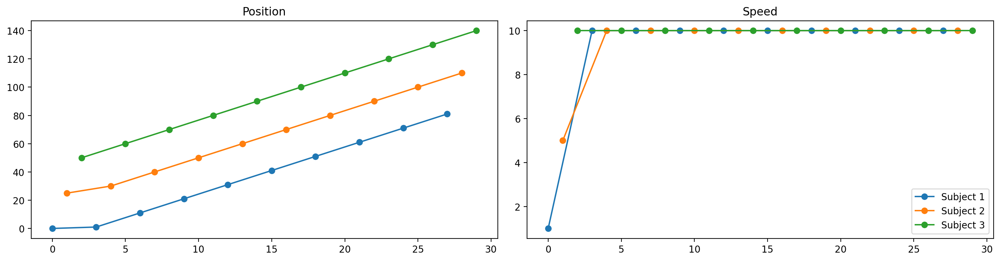

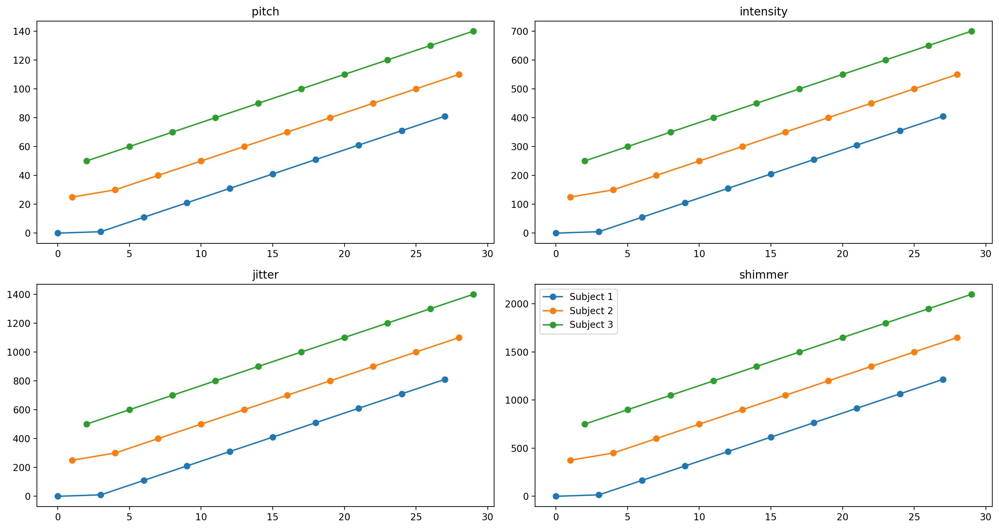

In [12]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=1,
    noise=0
)
model = VocalicModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

## Coordination = 0.2

As we lower coordination, the slower the component's speed converge to a common value but it still does if coordination persists. This tells us that persistent non-zero coordination in this model leads to convergence given enough time and no noise in the system. There's probably an analytical form to find the time when the speeds converge given some conditions (no variance, no gaps etc.).

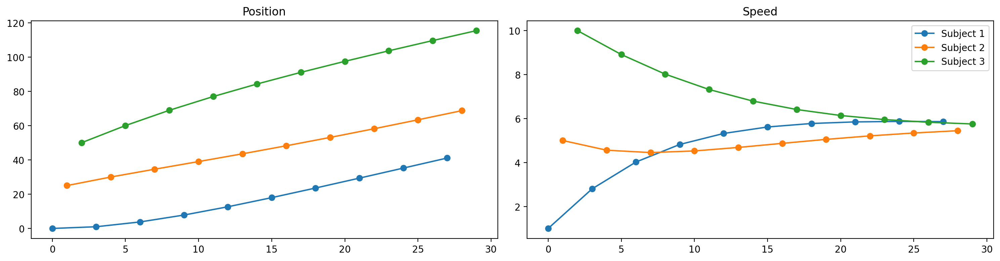

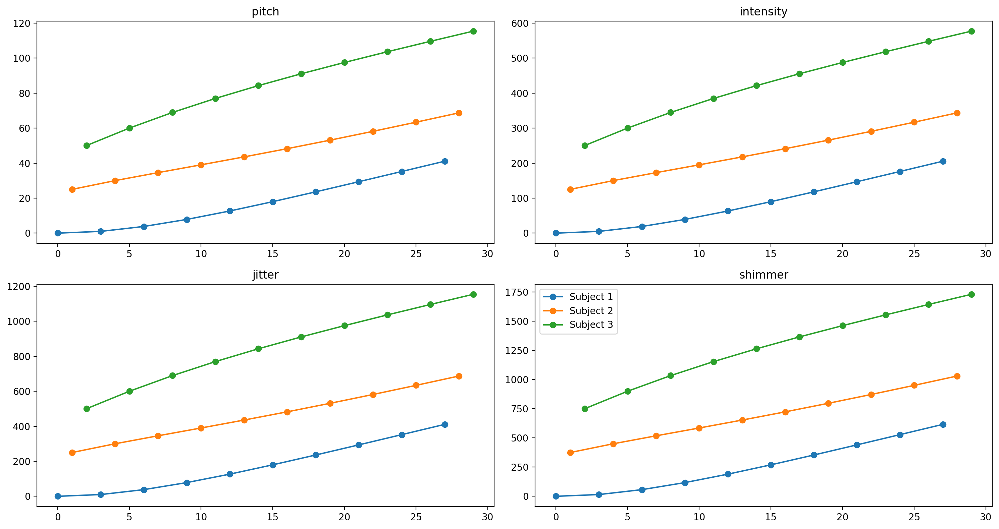

In [13]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0.2,
    noise=0
)
model = VocalicModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

# Normalization

In [14]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0.2,
    noise=0
)
model = VocalicModel(bundle)
samples = model.draw_samples()

## No normalization

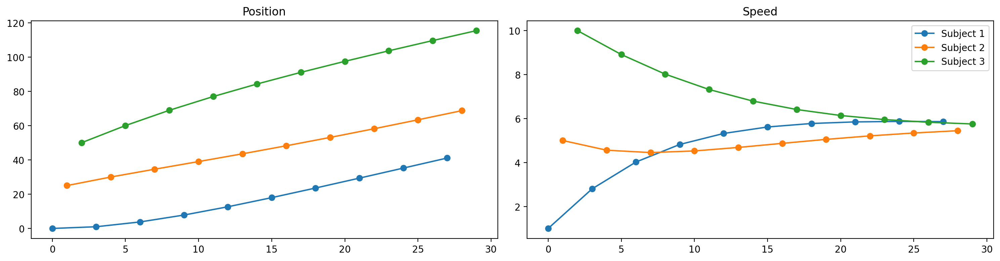

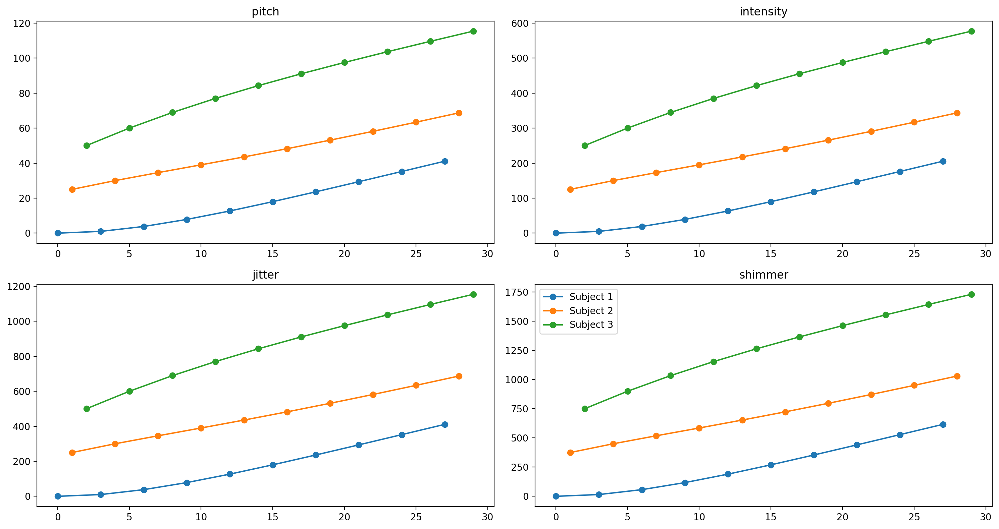

In [15]:
plot_state_space(samples)
plot_observations(samples)

## Normalization per feature

This normalization does not distort the data trend but adjusts each feature to smaller, shared range.

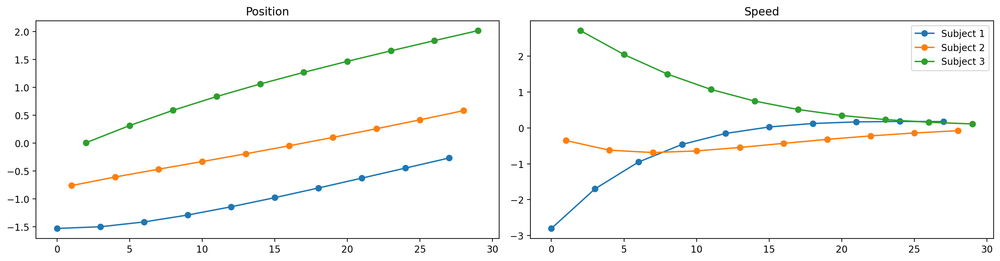

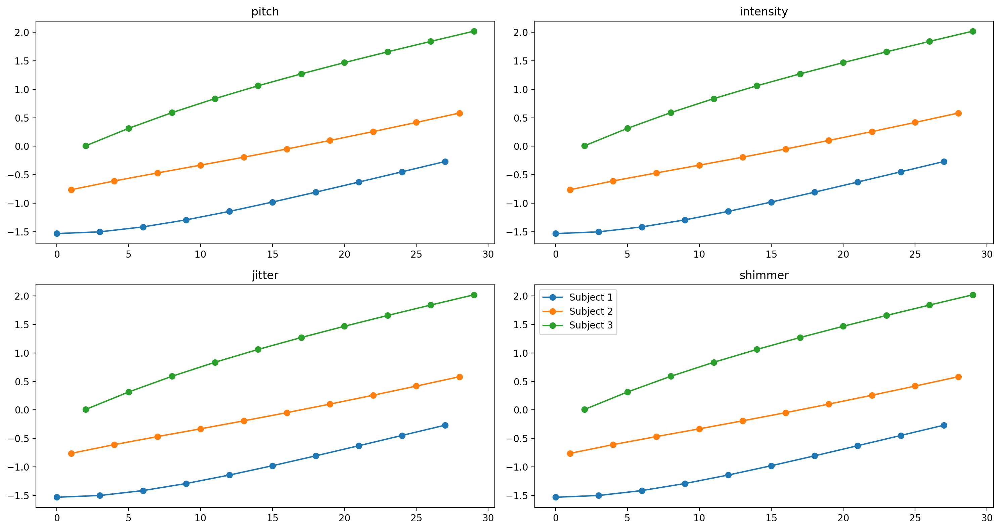

In [16]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["state_space"].values[0] = normalize_serialized_data_per_feature(
    data = samples_copy.component_group_samples["state_space"].values[0])
samples_copy.component_group_samples["speech_vocalics"].values[0] = normalize_serialized_data_per_feature(
    data = samples_copy.component_group_samples["speech_vocalics"].values[0])
plot_state_space(samples_copy)
plot_observations(samples_copy)

## Normalization per subject and feature

This type of normalization distorts data and should be avoided. Instead, we should fit different mean_a0 per subject to account for interpersonal differences.

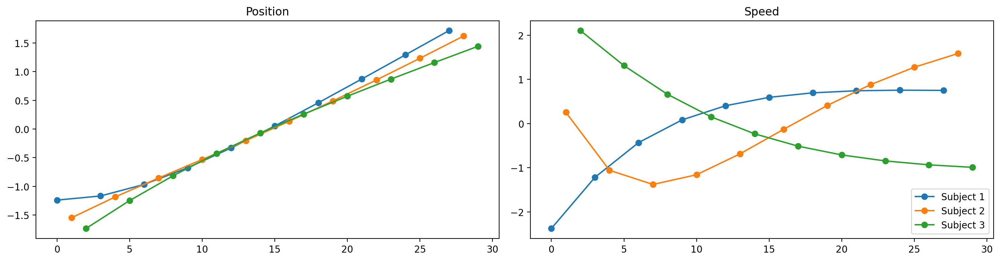

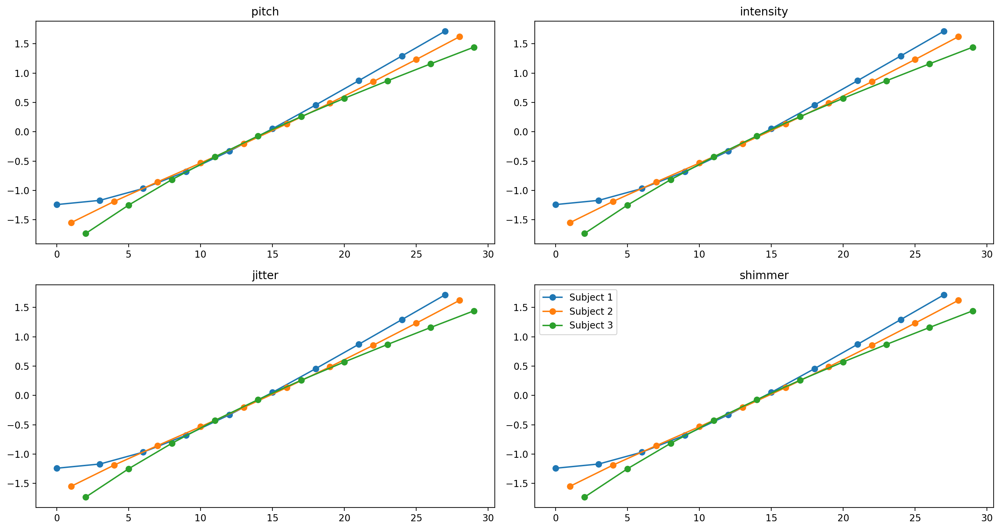

In [17]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["state_space"].values[0] = normalize_serialized_data_per_subject_and_feature(
    data = samples_copy.component_group_samples["state_space"].values[0],
    subject_indices= samples_copy.component_group_samples["state_space"].subject_indices[0],
    num_subjects=3)
samples_copy.component_group_samples["speech_vocalics"].values[0] = normalize_serialized_data_per_subject_and_feature(
    data = samples_copy.component_group_samples["speech_vocalics"].values[0],
    subject_indices= samples_copy.component_group_samples["speech_vocalics"].subject_indices[0],
    num_subjects=3)
plot_state_space(samples_copy)
plot_observations(samples_copy)

# Inference

In [28]:
template_bundle = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

model = VocalicModel(deepcopy(template_bundle))
data = model.draw_samples()
update_config_bundle_from_samples(template_bundle, data)

## No given parameters

In [ ]:
model = VocalicModel(deepcopy(template_bundle))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata1 = train(model)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [26]:
model.config_bundle.__dict__

{'num_time_steps_in_coordination_scale': 100,
 'sd_a': None,
 'sd_o': None,
 'weights': [array([[1, 1, 1, 1]])],
 'mean_a0': None,
 'coordination_samples': <coordination.module.coordination.sigmoid_gaussian_coordination.SigmoidGaussianCoordinationSamples at 0x7f7c7883dac0>,
 'observation_normalization': 'norm_per_feature',
 'observed_values': array([[-1.27569050e-02,  2.50148584e+01,  5.00079620e+01,
          1.02450833e+00,  2.99814501e+01,  6.00358981e+01,
          3.80997392e+00,  3.45543562e+01,  6.89762233e+01,
          7.87972183e+00,  3.90189382e+01,  7.70140256e+01,
          1.27304806e+01,  4.35388132e+01,  8.44018383e+01,
          1.81119240e+01,  4.82318558e+01,  9.12512740e+01,
          2.37836294e+01,  5.31474018e+01,  9.77014458e+01,
          2.96407750e+01,  5.82368590e+01,  1.03884863e+02,
          3.55540152e+01,  6.34885529e+01,  1.09887839e+02,
          4.14680002e+01,  6.89096061e+01,  1.15797621e+02,
          4.74031767e+01,  7.44236151e+01,  1.21617809e+

In [225]:
model.config_bundle.__dict__

{'num_time_steps_in_coordination_scale': 100,
 'sd_a': None,
 'sd_o': None,
 'weights': [array([[1, 1, 1, 1]])],
 'mean_a0': None,
 'coordination_samples': <coordination.module.coordination.sigmoid_gaussian_coordination.SigmoidGaussianCoordinationSamples at 0x7fc483e738b0>,
 'observation_normalization': 'norm_per_feature',
 'observed_values': array([[0.00000000e+00, 2.50000000e+01, 5.00000000e+01, 1.00000000e+00,
         3.00000000e+01, 6.00000000e+01, 3.80000000e+00, 3.45600000e+01,
         6.89120000e+01, 7.82240000e+00, 3.90124800e+01, 7.69320960e+01,
         1.26443392e+01, 4.35388518e+01, 8.42534472e+01, 1.79661608e+01,
         4.82243136e+01, 9.10476205e+01, 2.35824527e+01, 5.30959414e+01,
         9.74572847e+01, 2.93574191e+01, 5.81482370e+01, 1.03595475e+02,
         3.52050303e+01, 6.33595956e+01, 1.09548299e+02, 4.10736841e+01,
         6.87024133e+01, 1.15379122e+02],
        [0.00000000e+00, 1.25000000e+02, 2.50000000e+02, 5.00000000e+00,
         1.50000000e+02, 3.000

## Fixed sd_uc = 0.01

In [ ]:
model = VocalicModel(deepcopy(template_bundle))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.01
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata2 = train(model)

## Tighter prior for sd_uc

In [ ]:
model = VocalicModel(deepcopy(template_bundle))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.sd_sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1,1,1]])] # Important if normalization per feature is used

idata3 = train(model)

## No given parameters (longer burn-in)

Normalizing observations per feature


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 5375 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   2.227998  0.000000
1  unbounded_coordination   2.525991  0.481407
2     state_space_mean_a0   2.292495  0.258607
3             state_space   2.578481  0.549447
4      coordination_sd_uc   2.651408  0.000000
5        state_space_sd_a   2.591756  0.000000
6    speech_vocalics_sd_o   1.129227  0.000000
7            coordination   2.528488  0.477997


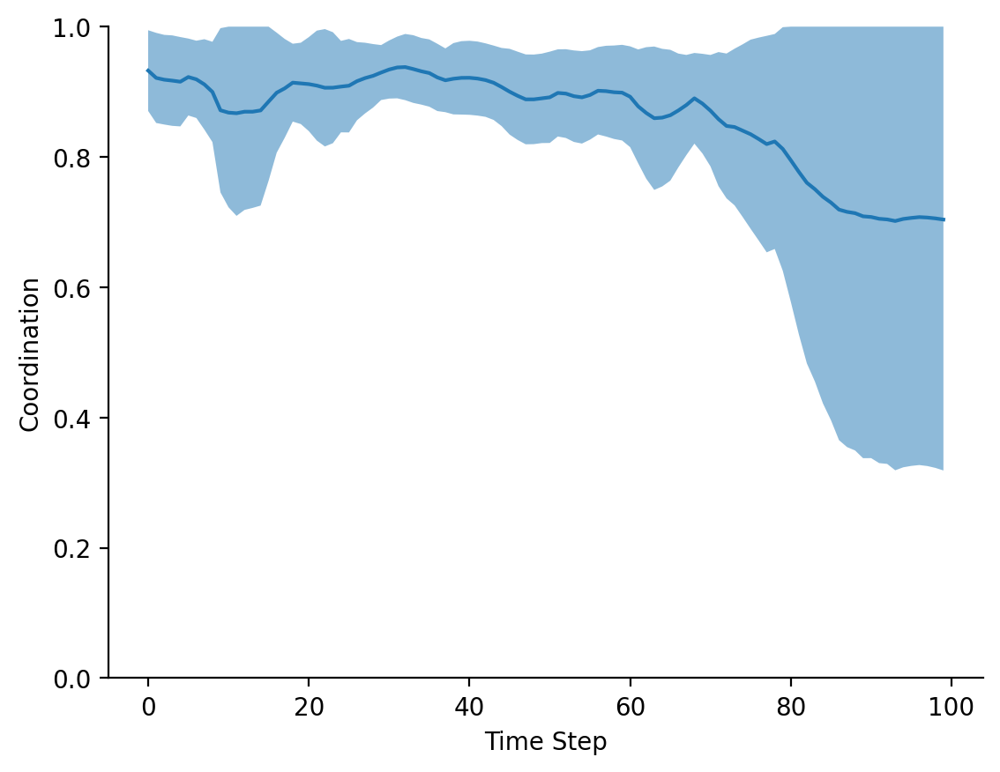

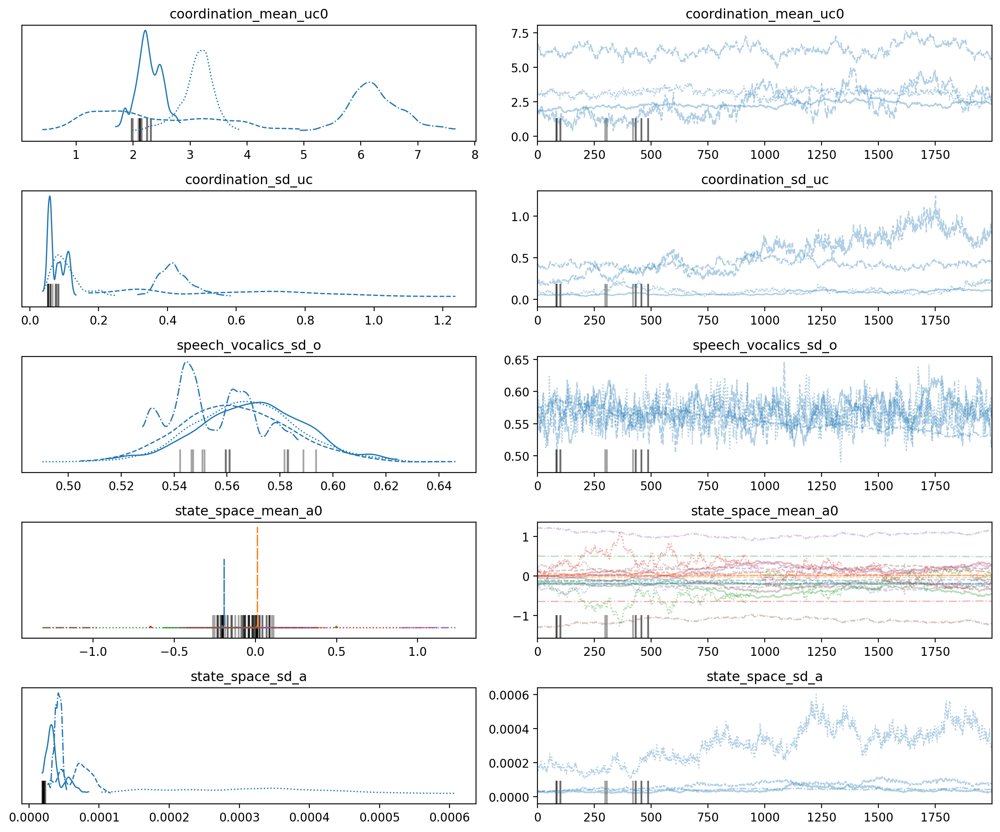

In [140]:
model = VocalicModel(deepcopy(template_model.config_bundle))
model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None

idata4 = train(model, burn_in=4000)

<Axes: xlabel='Time Step', ylabel='speed'>

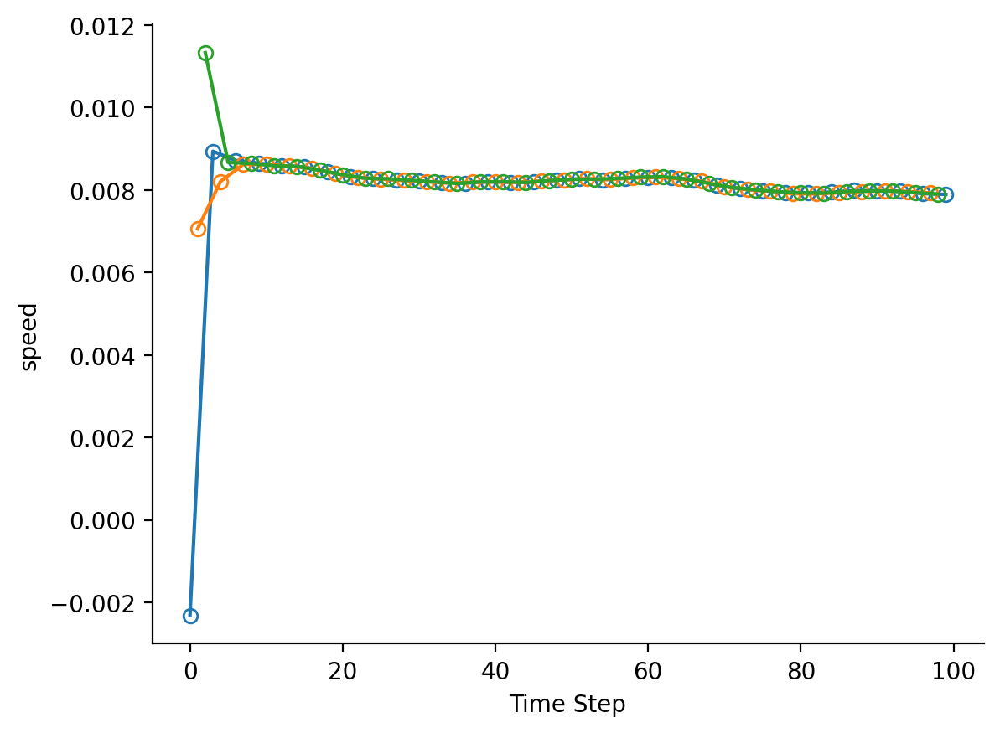

In [147]:
idata4.plot_time_series_posterior("state_space", False, dimension=1)

## No given paramaters (looser state space sd_a prior)

Normalizing observations per feature


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 2692 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   2.170560  0.000000
1  unbounded_coordination   2.270703  0.455833
2     state_space_mean_a0   1.778566  0.057462
3             state_space   2.241668  0.521377
4      coordination_sd_uc   2.601817  0.000000
5        state_space_sd_a   1.492123  0.000000
6    speech_vocalics_sd_o   1.006502  0.000000
7            coordination   2.270498  0.456077


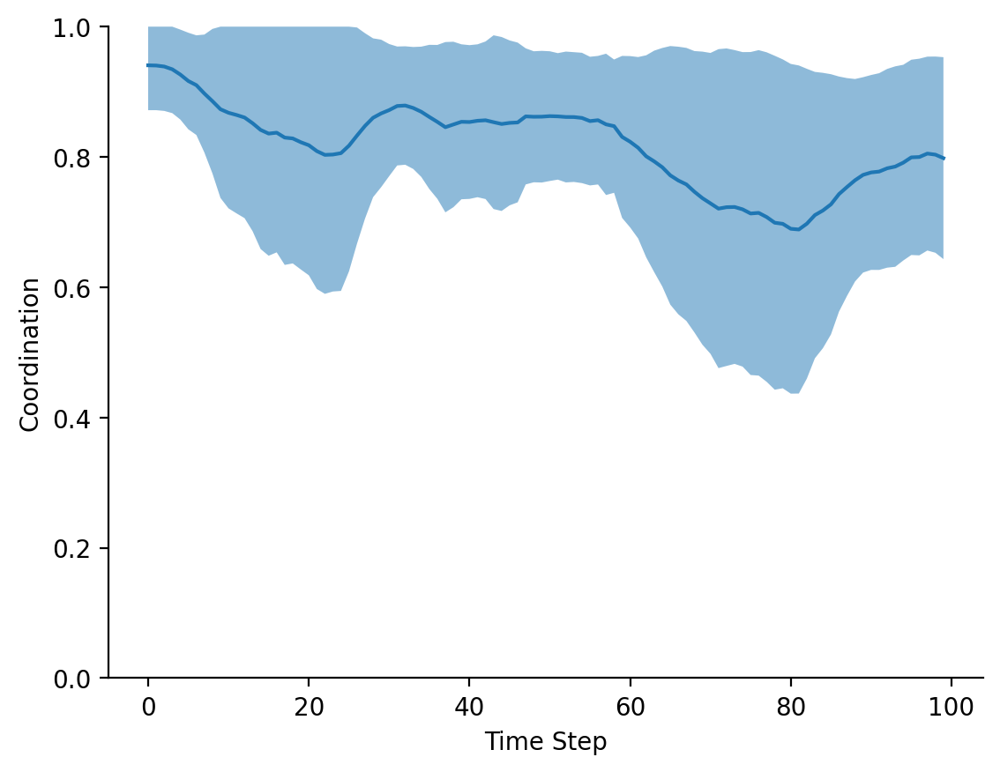

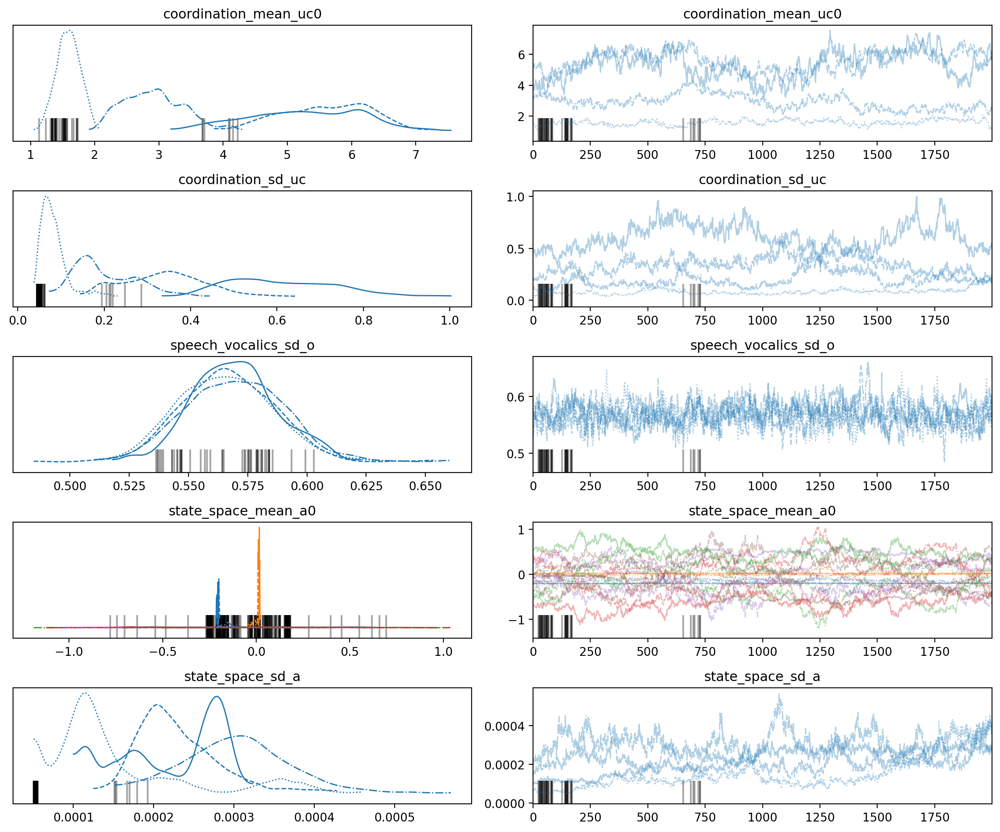

In [163]:
bundle = deepcopy(template_bundle)
bundle.sd_sd_a = 10 # looser prior

bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None

model = VocalicModel(bundle)
model.prepare_for_sampling()
samples = template_model.draw_samples()
update_config_bundle_from_samples(model.config_bundle, samples)

idata5 = train(model)

## No given paramaters (looser state space mean_a0 prior)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 2604 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   2.056653  0.000000
1  unbounded_coordination   2.137328  0.296340
2     state_space_mean_a0   2.586680  0.260290
3             state_space   2.099025  0.609229
4      coordination_sd_uc   1.471701  0.000000
5        state_space_sd_a   2.082406  0.000000
6    speech_vocalics_sd_o   1.009006  0.000000
7            coordination   2.137328  0.296340


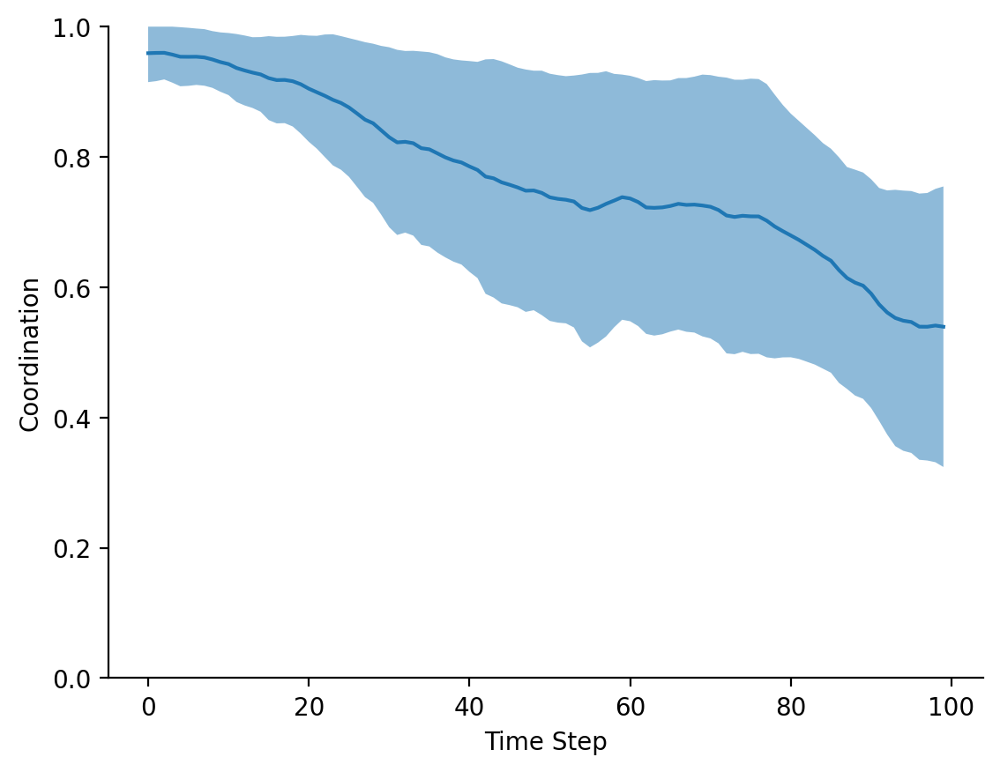

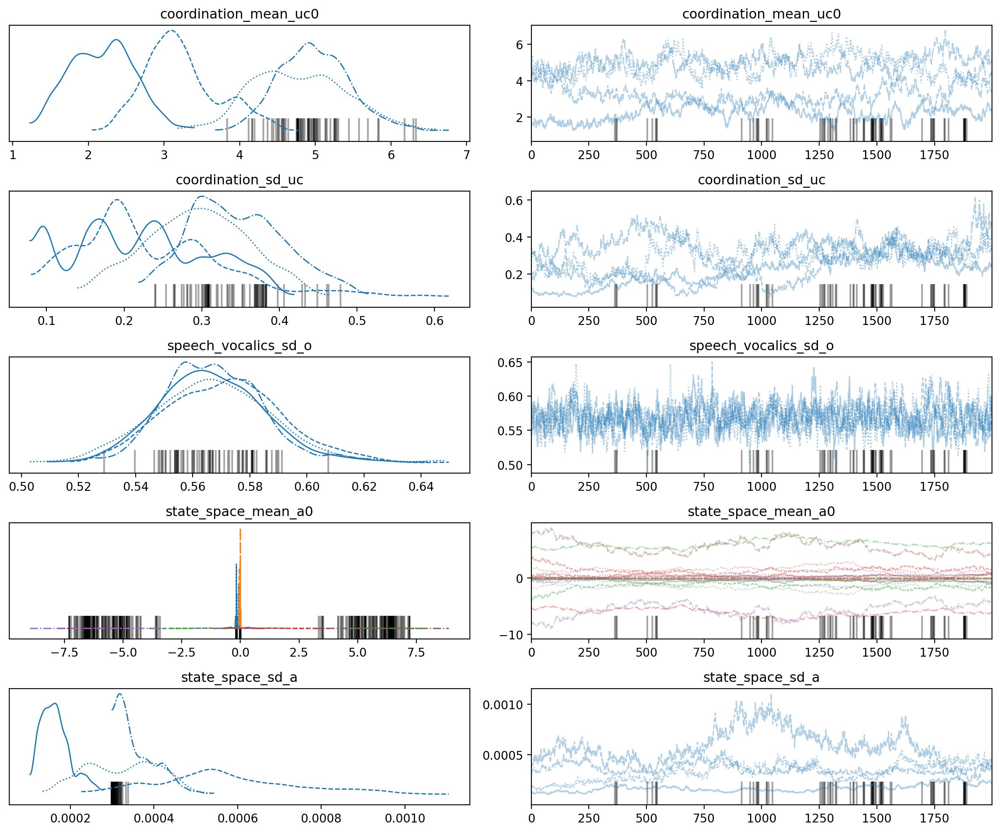

In [185]:
bundle = deepcopy(template_bundle)
bundle.sd_mean_a0 = 100 # looser prior

bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None

model = VocalicModel(bundle)
model.prepare_for_sampling()
samples = template_model.draw_samples()
update_config_bundle_from_samples(model.config_bundle, samples)

idata6 = train(model)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 989 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.180438  0.000000
1  unbounded_coordination   1.170812  0.046863
2     state_space_mean_a0   1.025274  0.018728
3             state_space   1.001236  0.003670
4      coordination_sd_uc   1.521175  0.000000
5        state_space_sd_a   1.013826  0.000000
6    speech_vocalics_sd_o   1.000556  0.000000
7            coordination   1.172064  0.047464


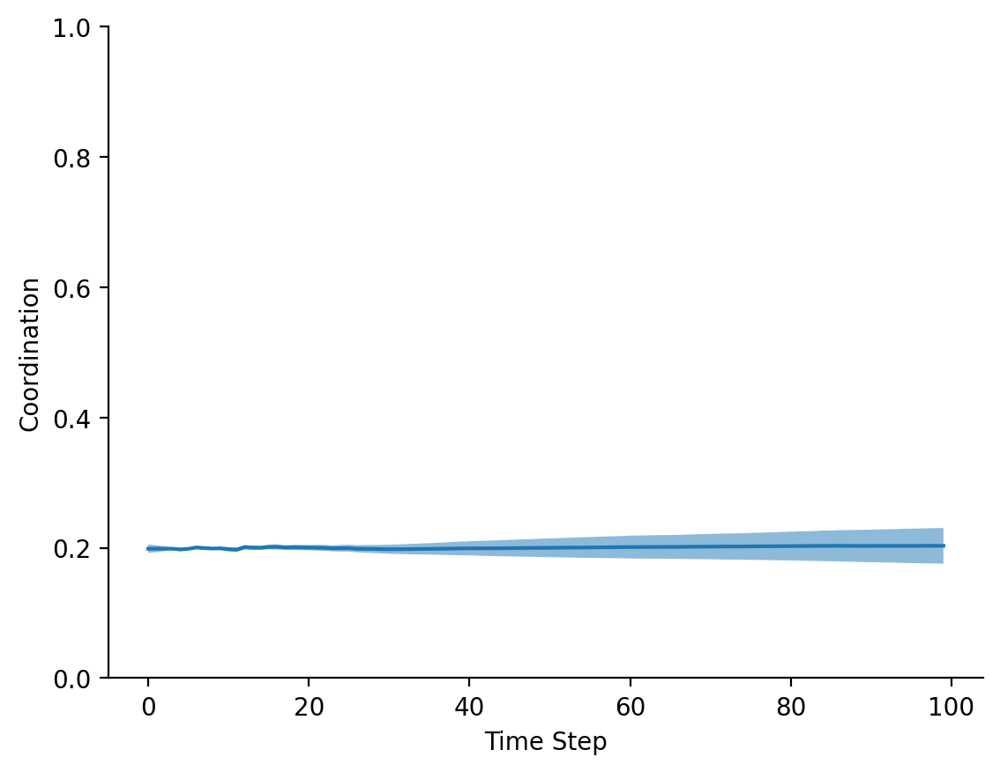

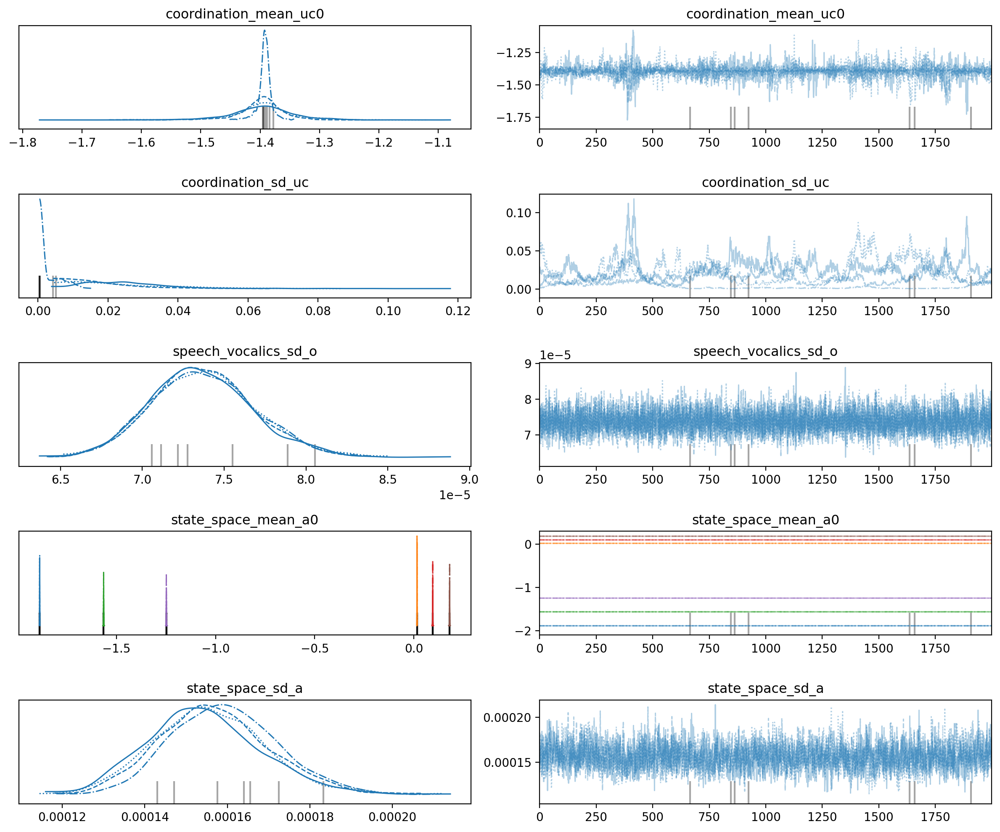

In [199]:
bundle = deepcopy(template_bundle)
bundle.weights = [np.array([[1,1,1,1]])]

bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None

model = VocalicModel(bundle)
model.prepare_for_sampling()
samples = template_model.draw_samples()
update_config_bundle_from_samples(model.config_bundle, samples)

idata7 = train(model)

Sampling: [coordination_mean_uc0, coordination_sd_uc, speech_vocalics, speech_vocalics_sd_o, state_space, state_space_mean_a0, state_space_sd_a, state_space_to_speech_vocalics_mlp_weights_in, unbounded_coordination]


Observations (speech_vocalics) will be normalized per feature.


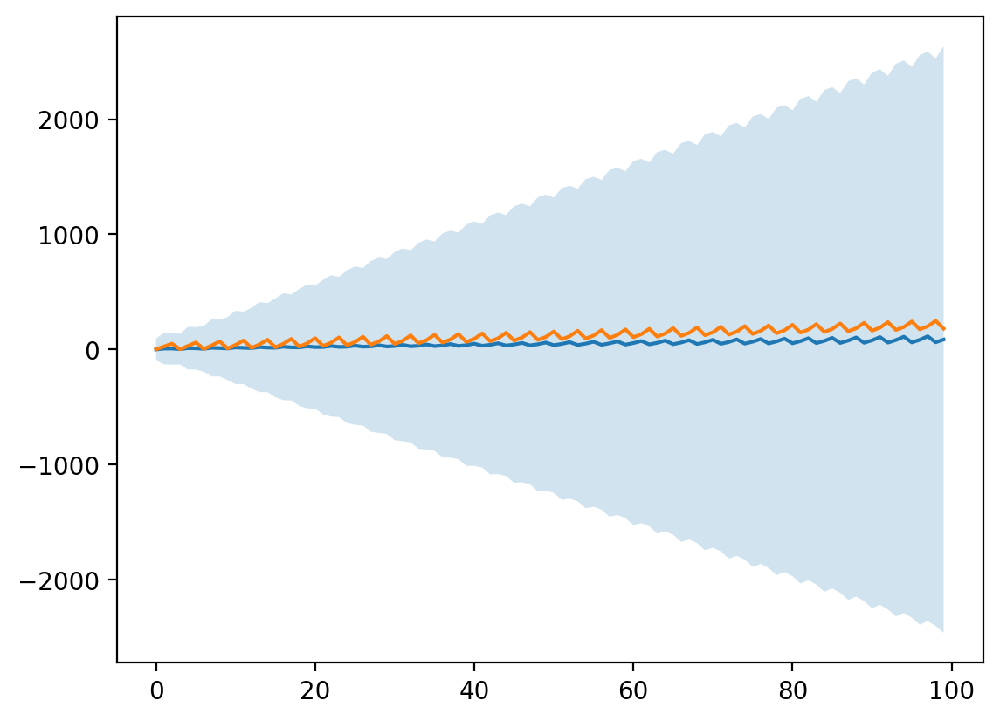

In [184]:
bundle = deepcopy(template_bundle)
bundle.sd_mean_a0 = 100 # looser prior

bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None

model = VocalicModel(bundle)
model.prepare_for_sampling()
samples = template_model.draw_samples()
update_config_bundle_from_samples(model.config_bundle, samples)

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata_pp = model.prior_predictive()
means, std = idata_pp.average_prior_predictive_samples("speech_vocalics", return_std=True)
fig = plt.figure()
m = means.sel(speech_vocalics_dimension = "pitch")
s = std.sel(speech_vocalics_dimension = "pitch")
plt.plot(np.arange(100), m)
plt.fill_between(np.arange(100), m - s, m + s, alpha=0.2)
plt.plot(np.arange(100), samples.component_group_samples["speech_vocalics"].values[0][0])

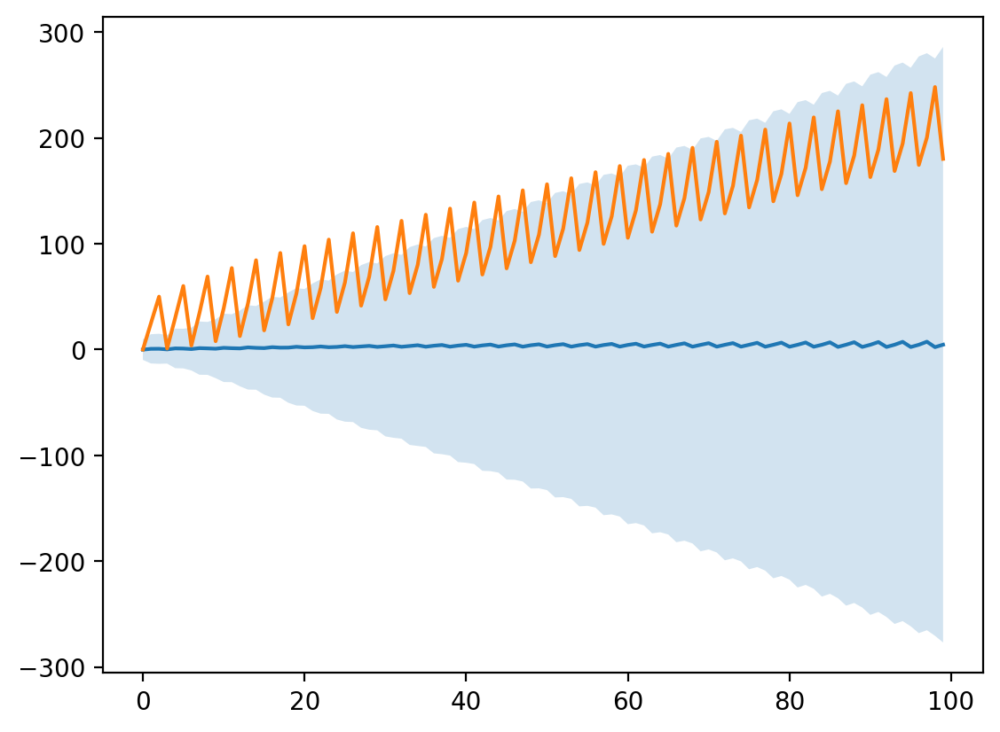

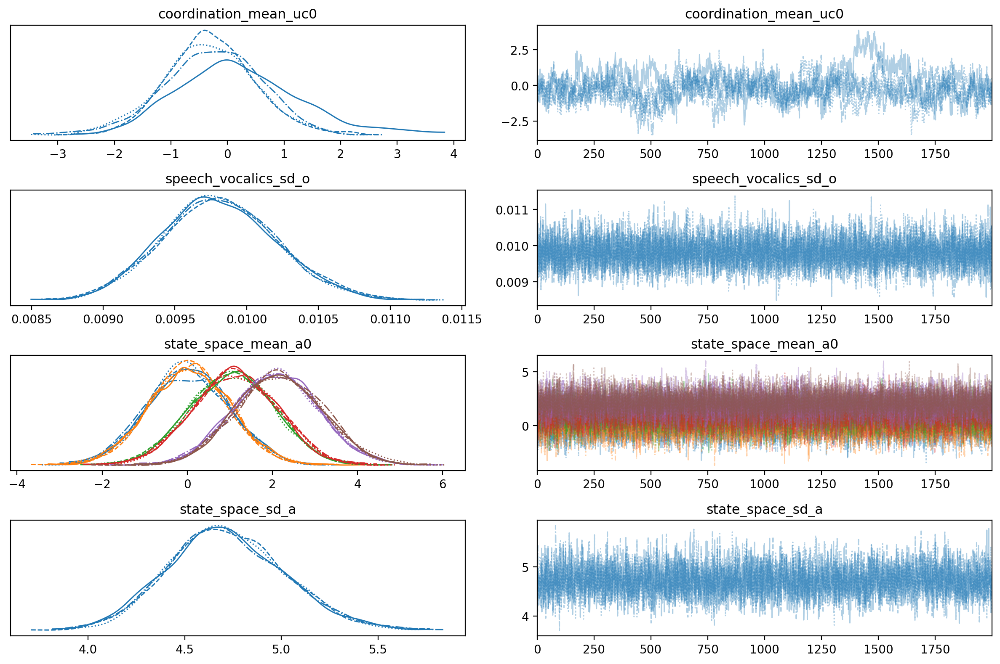

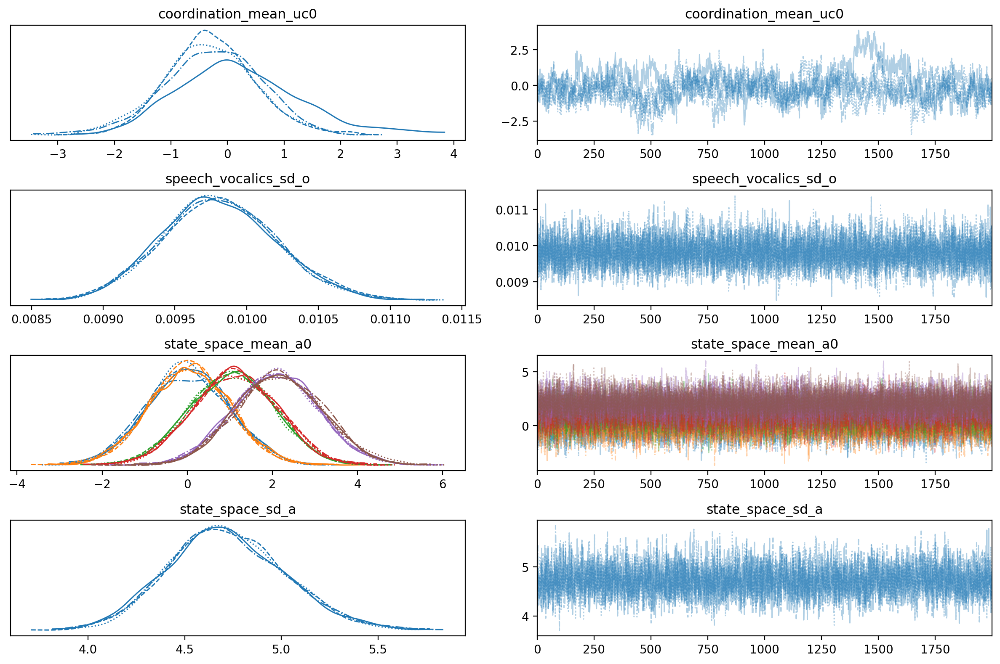

In [111]:
idata3.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, state_space_to_speech_vocalics_mlp_weights_in, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 4327 seconds.


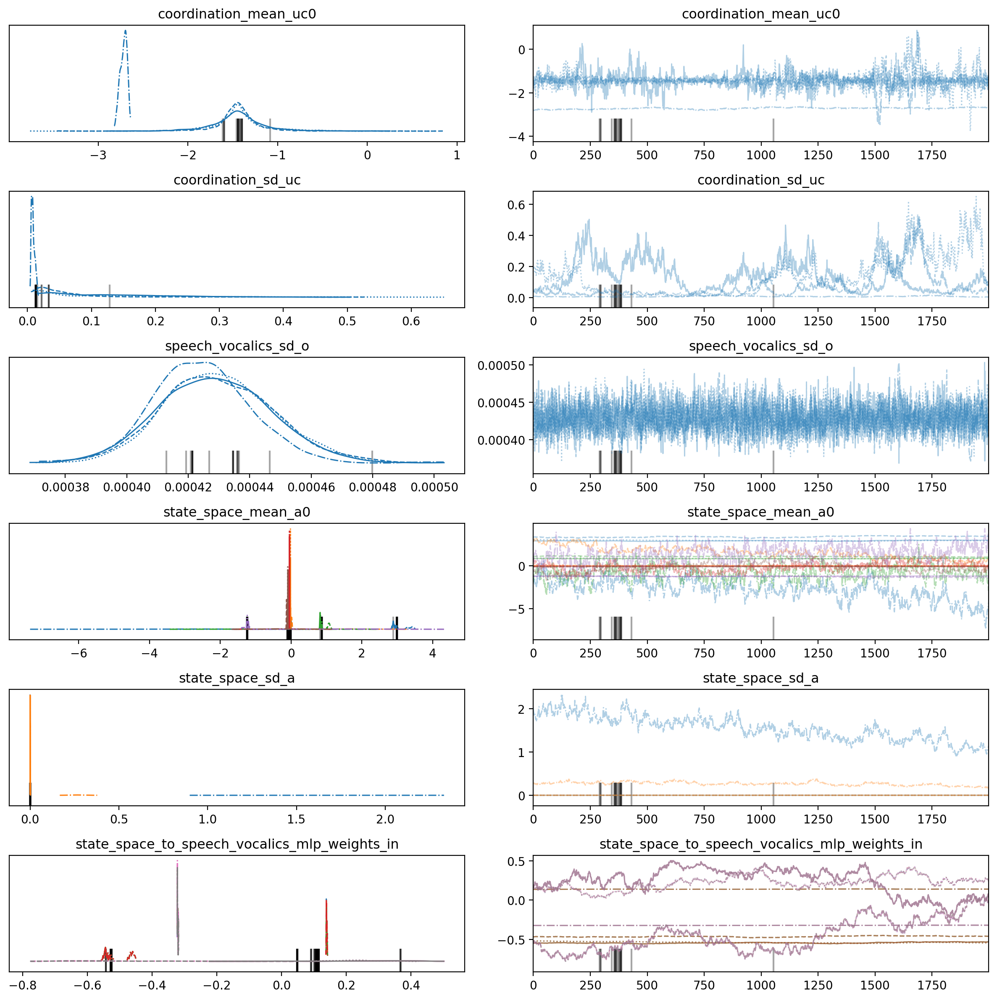

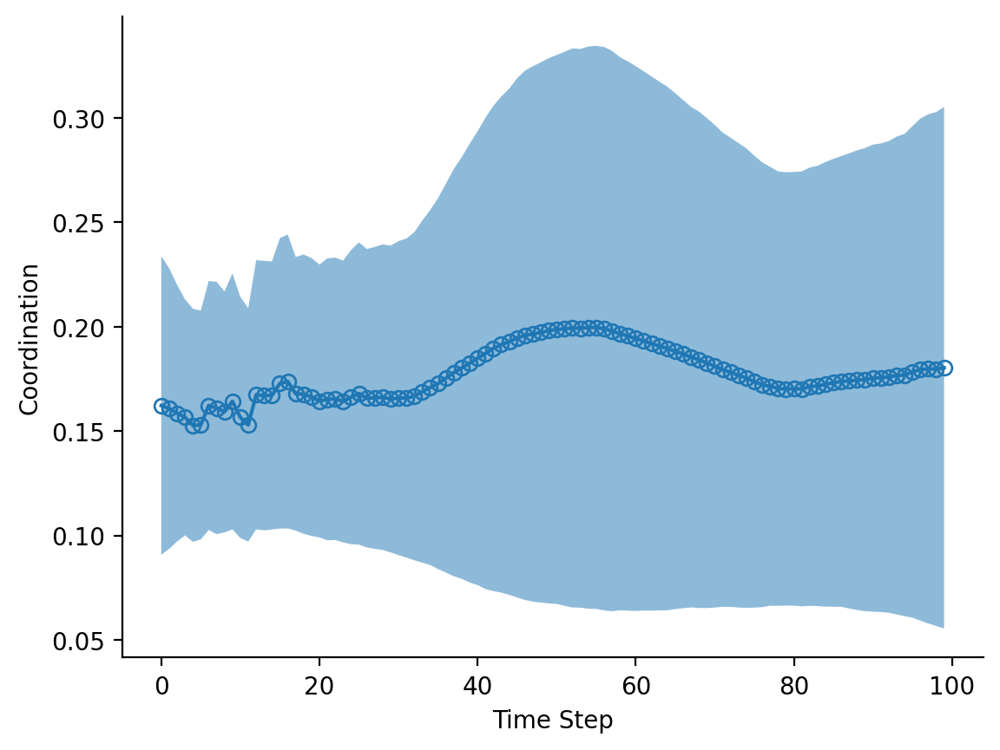

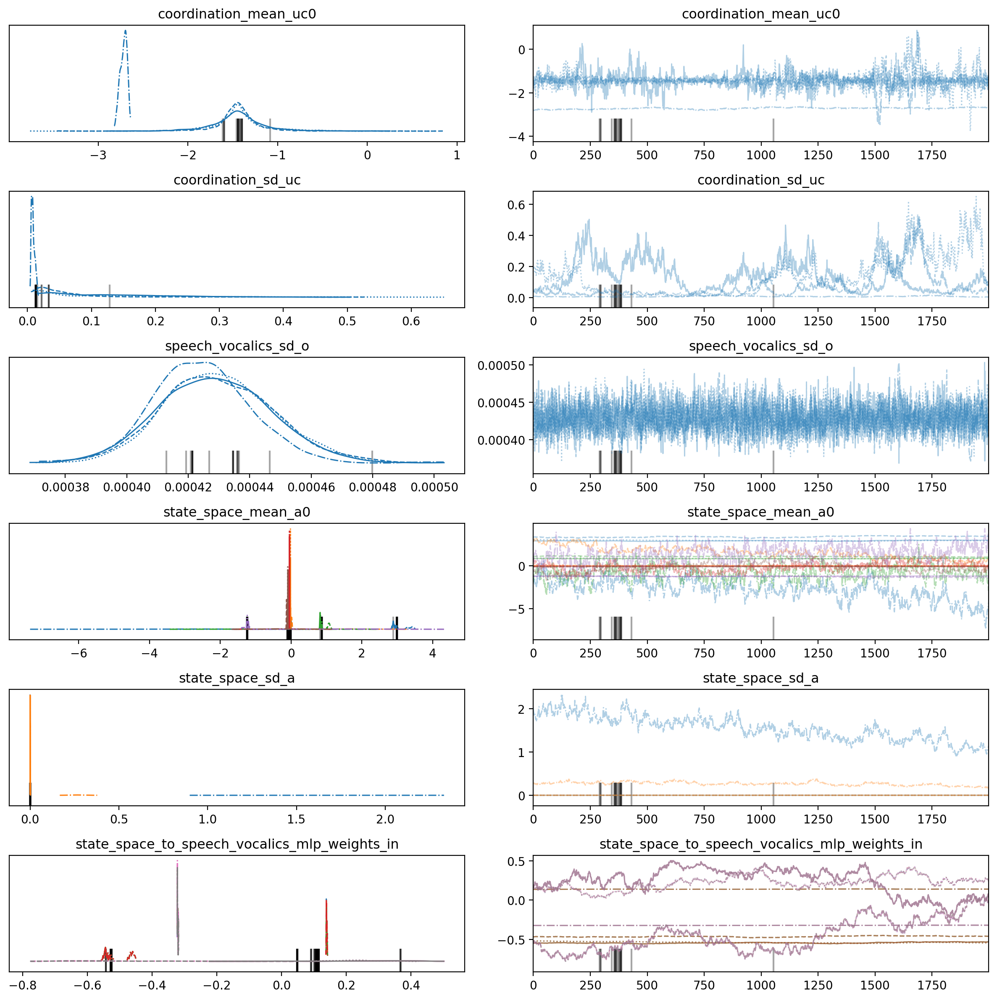

In [24]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
bundle.weights = [None]
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 637 seconds.


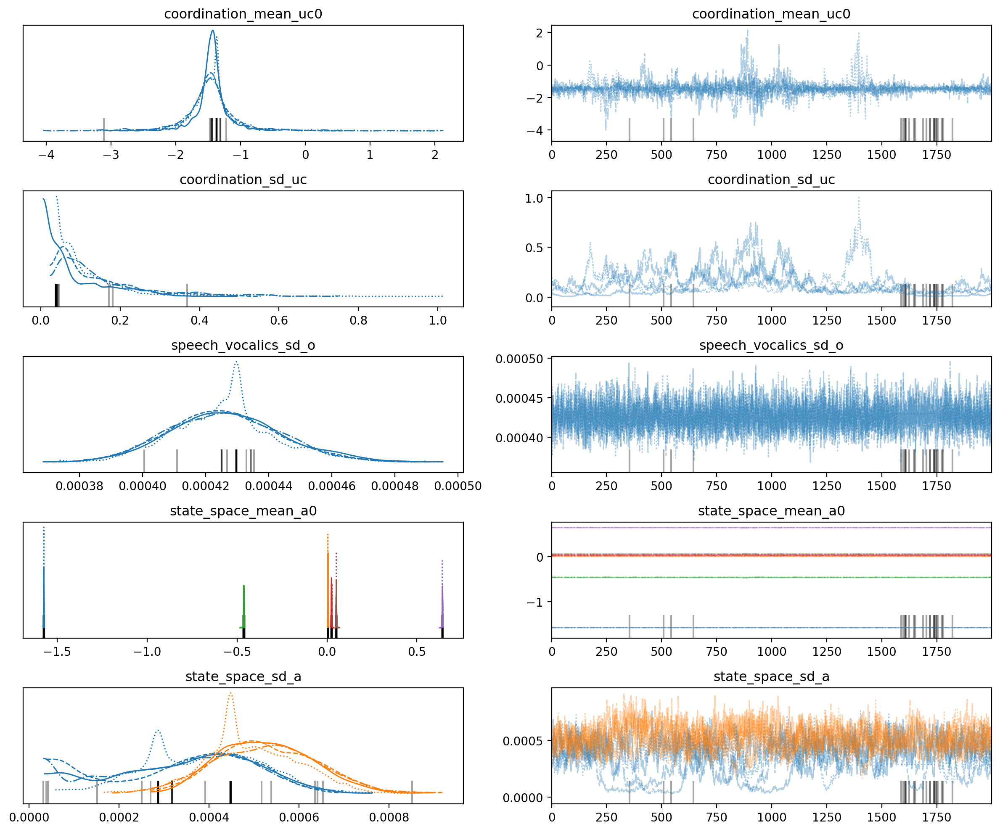

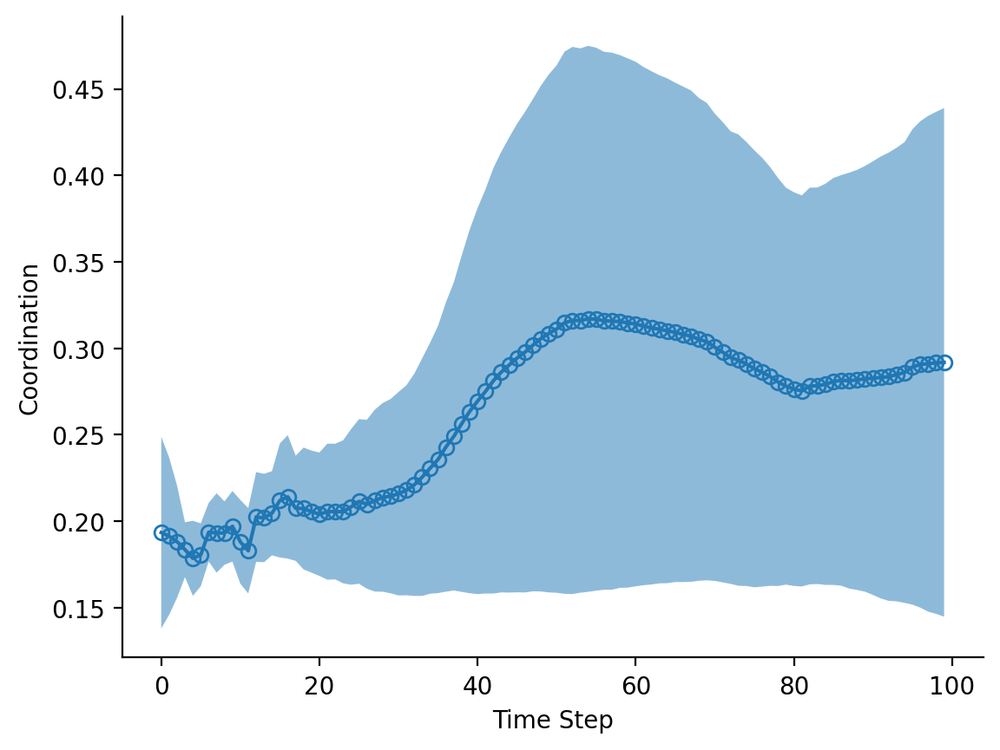

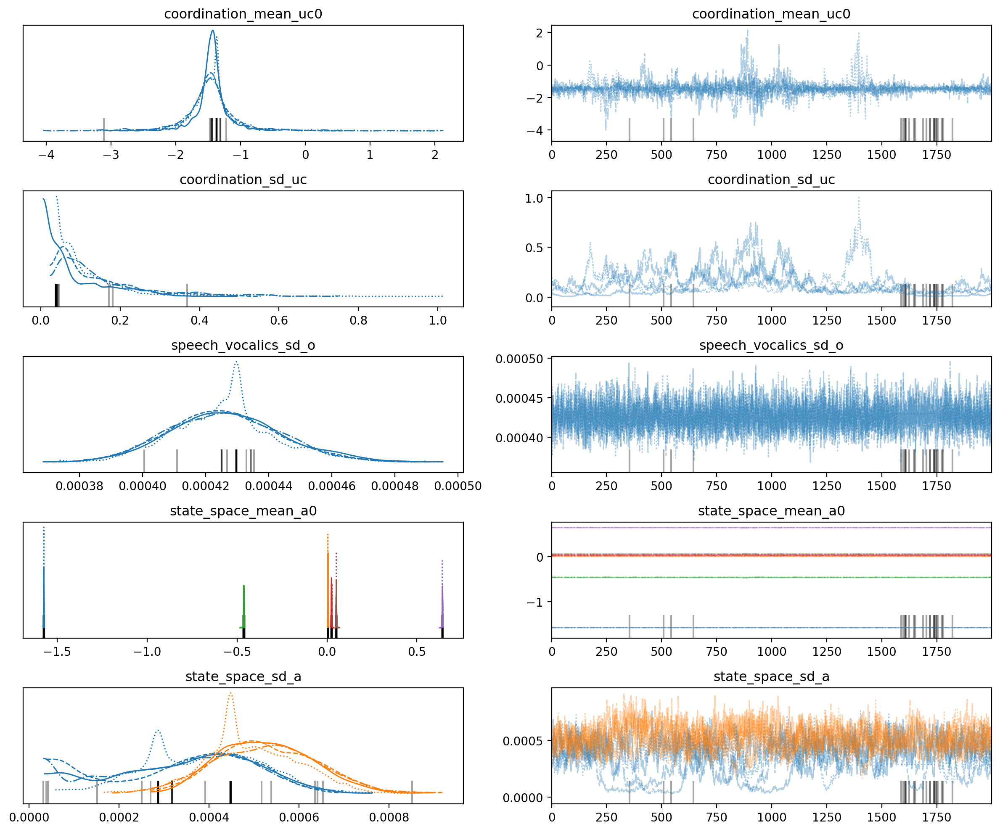

In [25]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit(burn_in=4000)
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [unbounded_coordination, state_space_mean_a0, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 166 seconds.


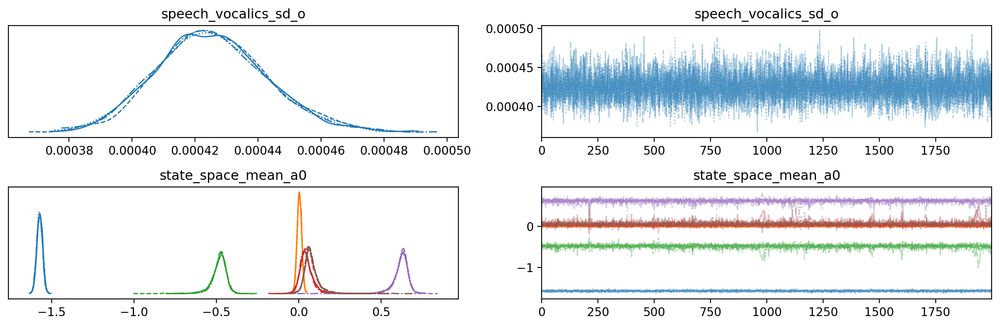

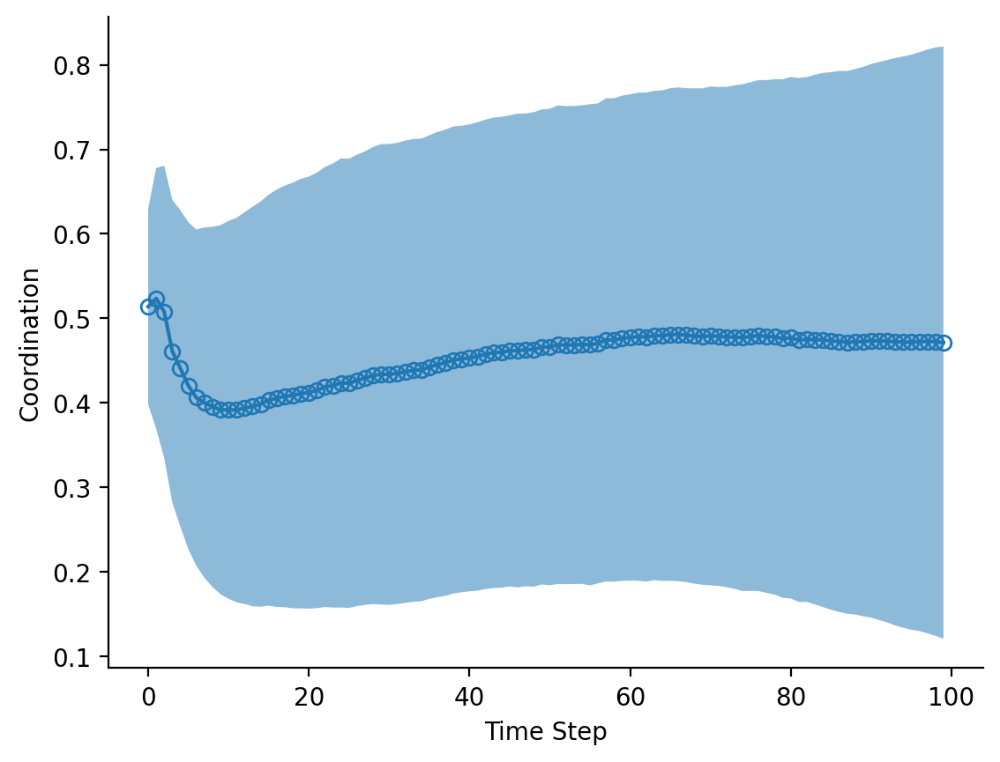

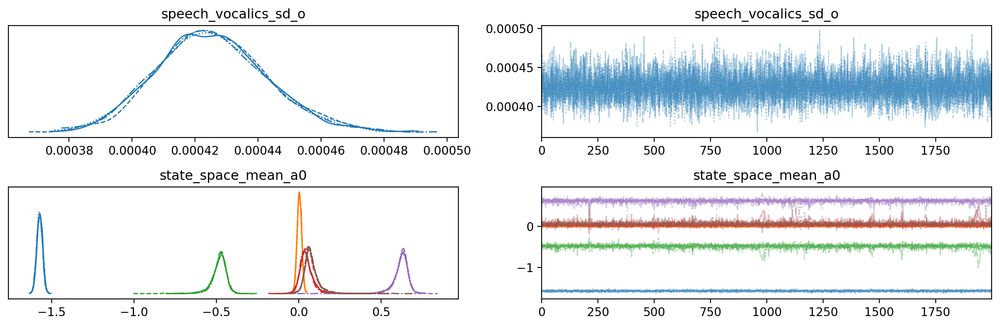

In [26]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
# bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
# bundle.mean_uc0 = None
# bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, state_space_to_speech_vocalics_mlp_weights_in, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 3298 seconds.


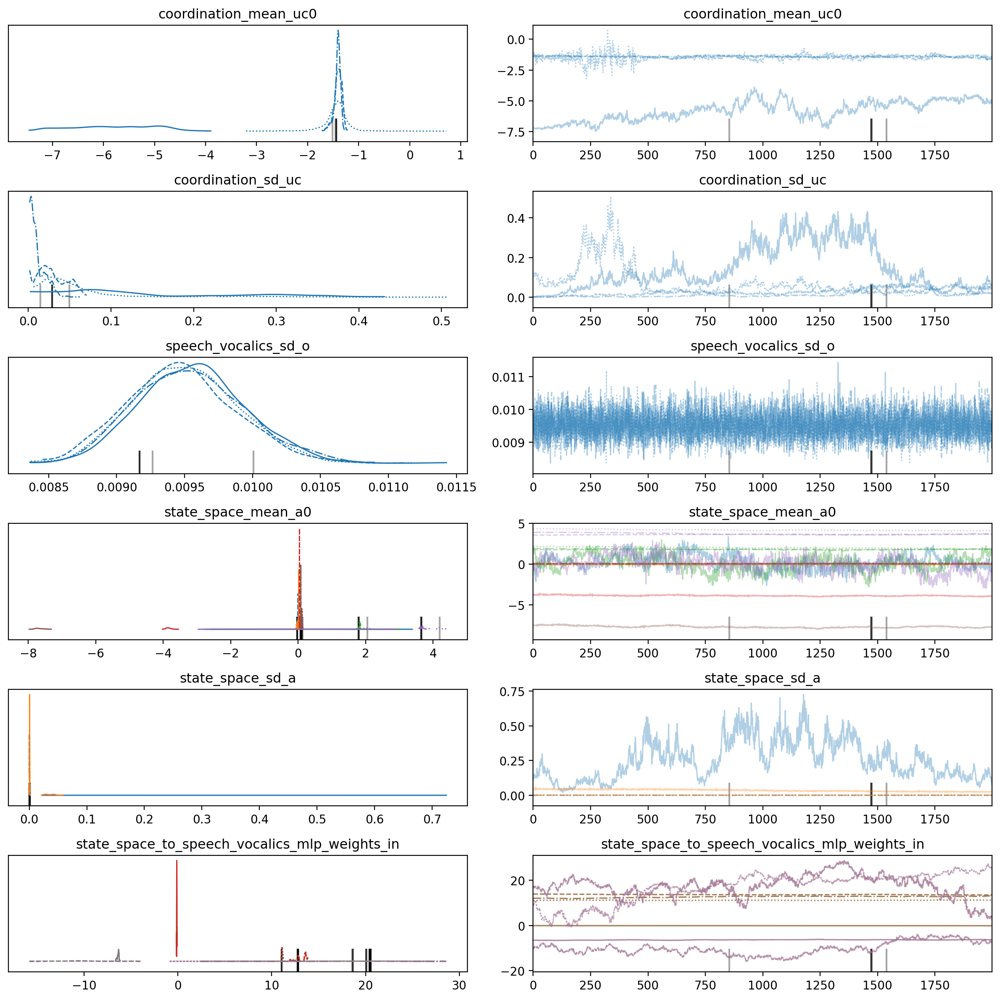

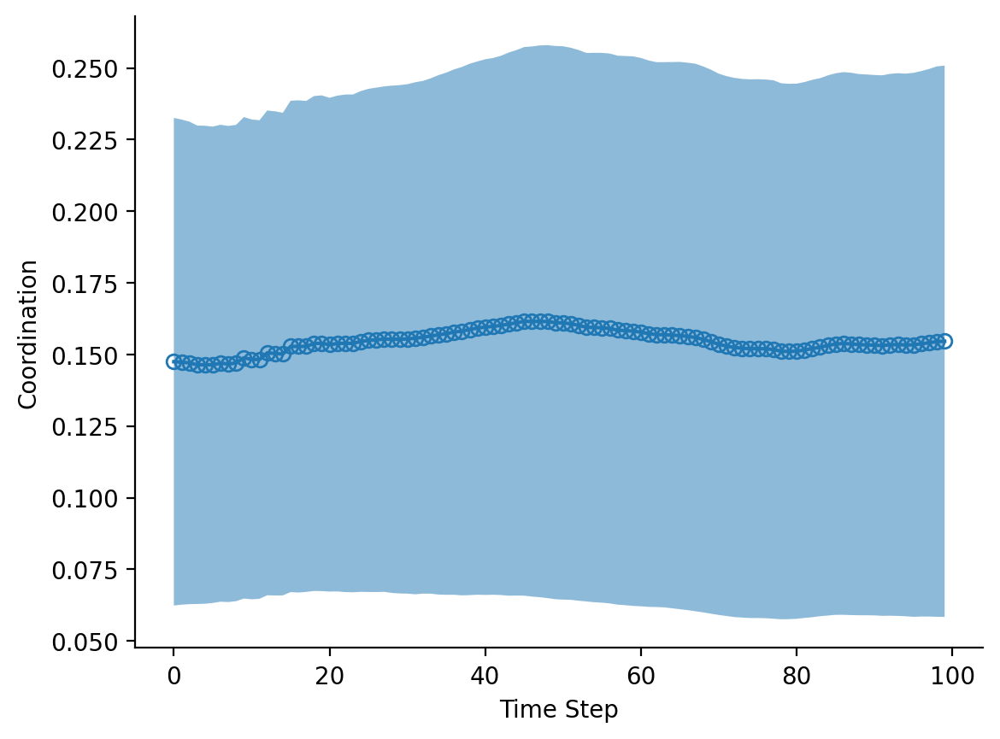

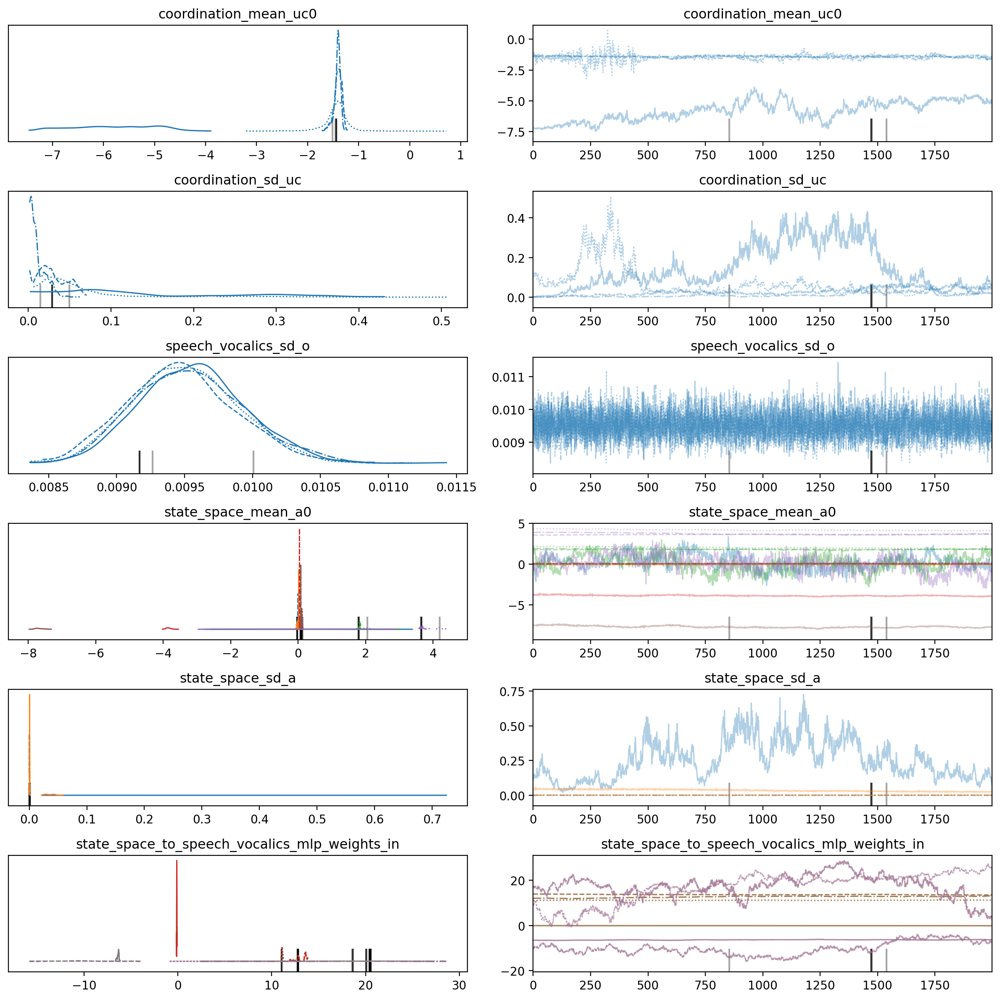

In [27]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
# bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.sd_w0 = 50
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
bundle.weights = [None]
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit(burn_in=4000)
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1081 seconds.


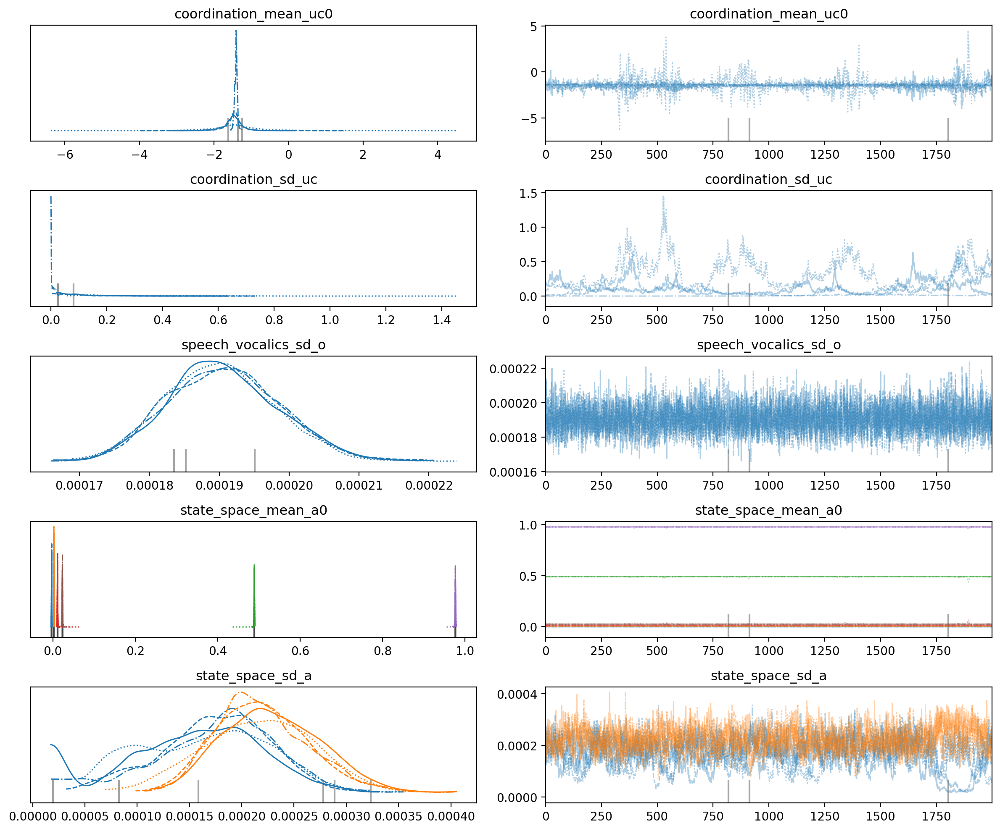

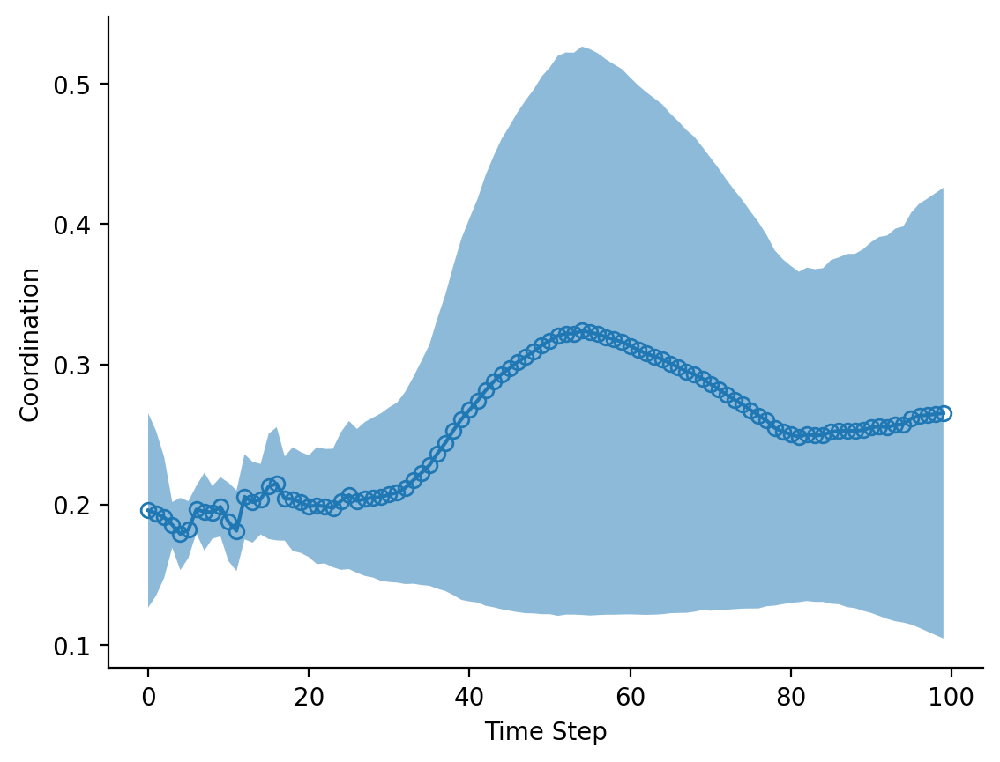

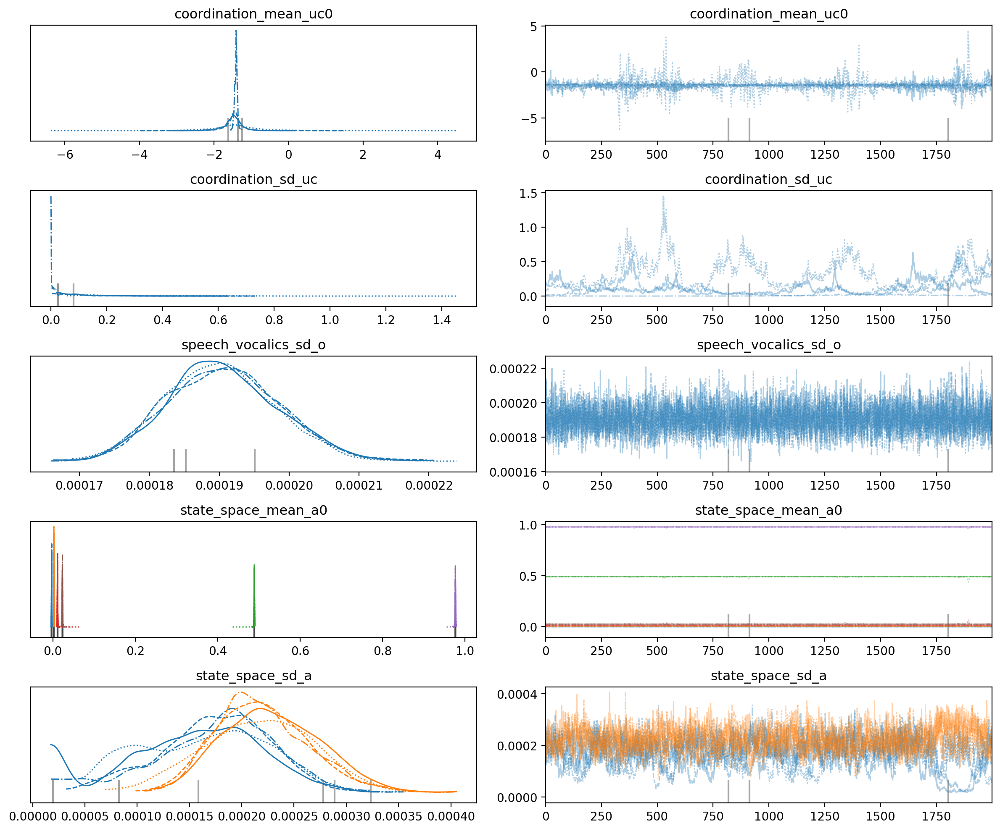

In [28]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = None#"norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0] / 50
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [unbounded_coordination, state_space_mean_a0, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 162 seconds.


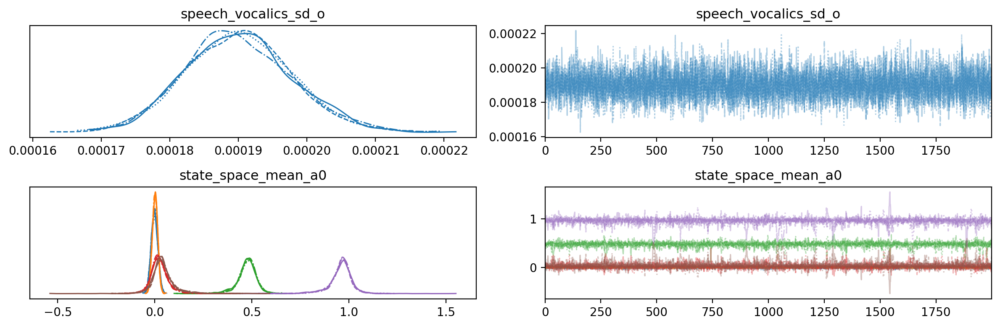

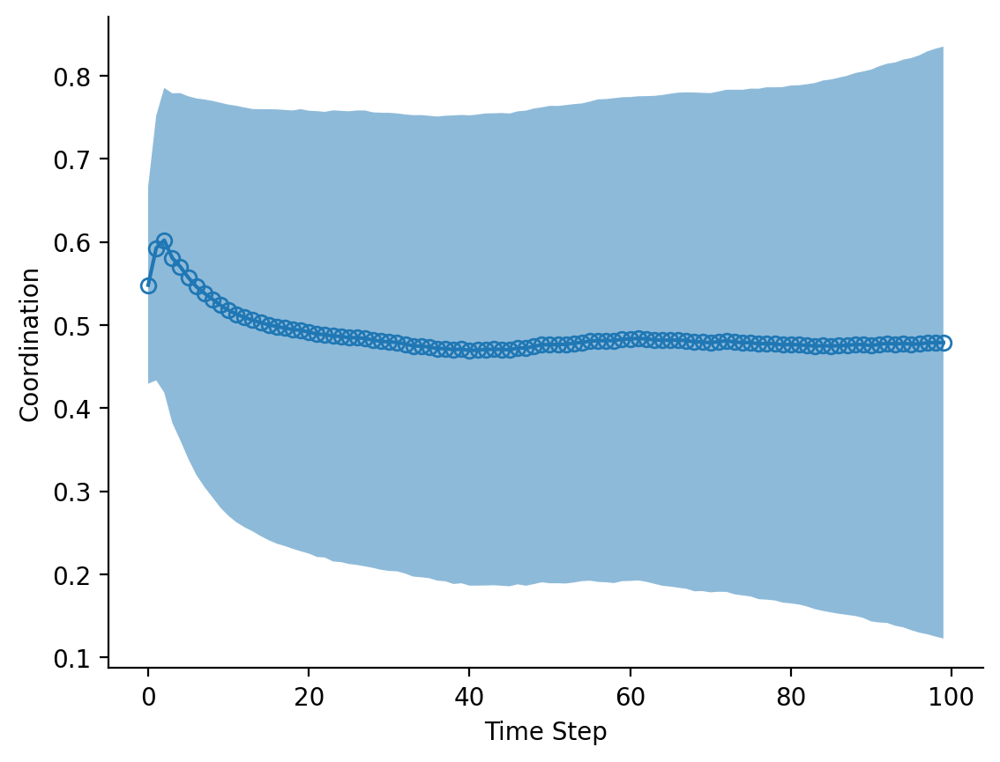

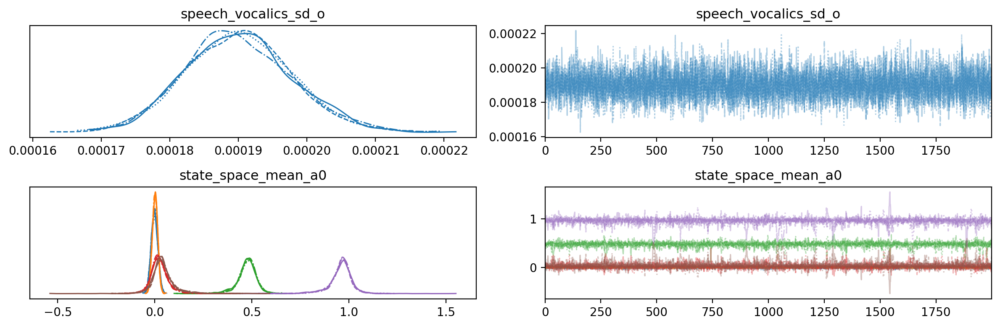

In [29]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = None #"norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0] / 50
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
# bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
# bundle.mean_uc0 = None
# bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [unbounded_coordination, state_space_mean_a0, state_space, state_space_to_speech_vocalics_mlp_weights_in, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1855 seconds.


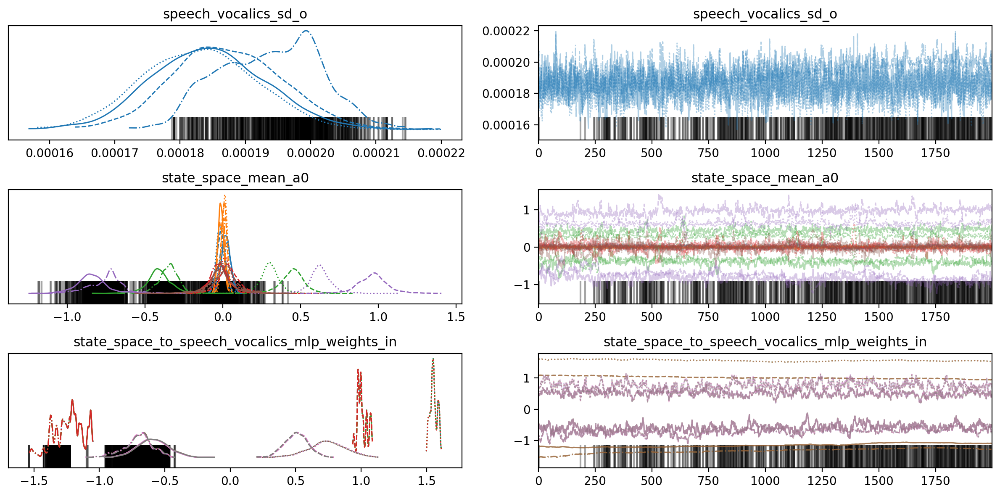

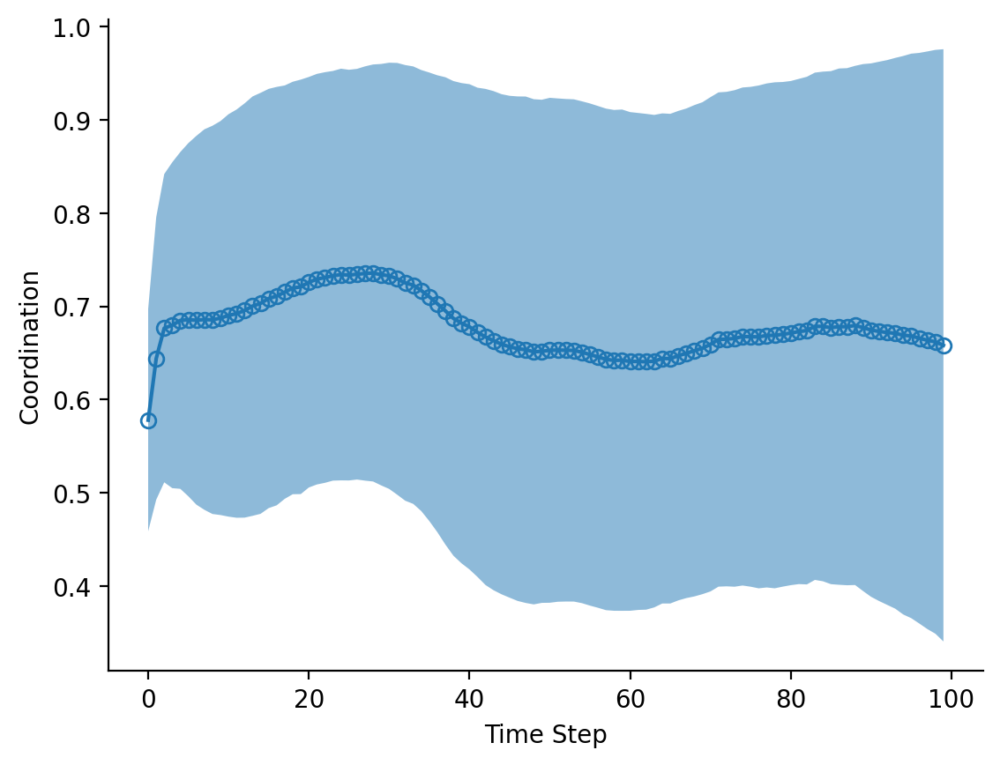

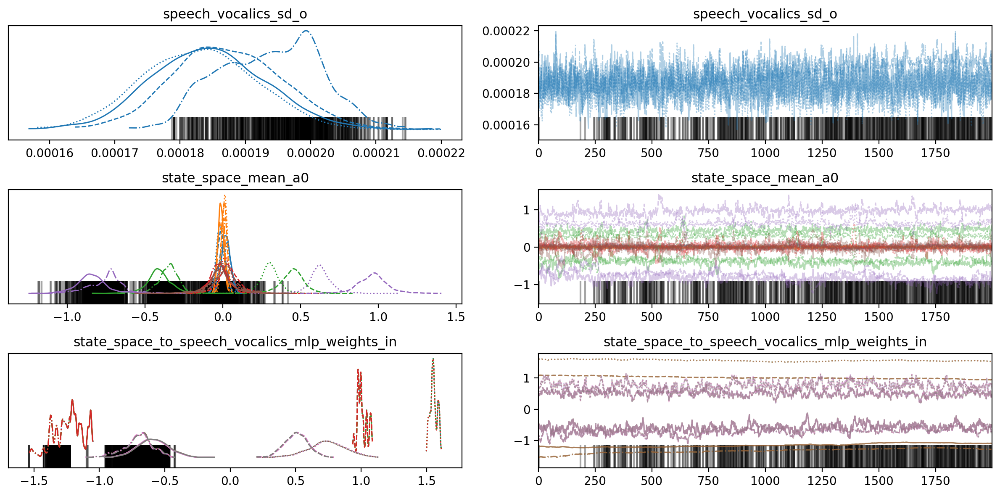

In [30]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = None #"norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0] / 50
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
# bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
# bundle.mean_uc0 = None
# bundle.sd_uc = None
# bundle.p = None
bundle.weights = [None]

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [unbounded_coordination, state_space_mean_a0, state_space]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 225 seconds.


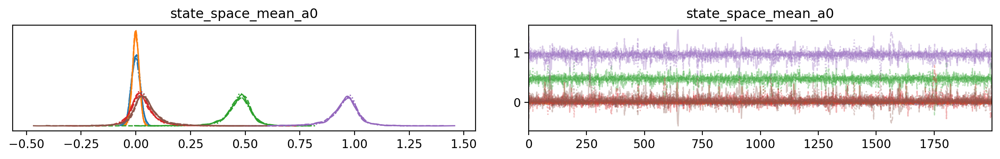

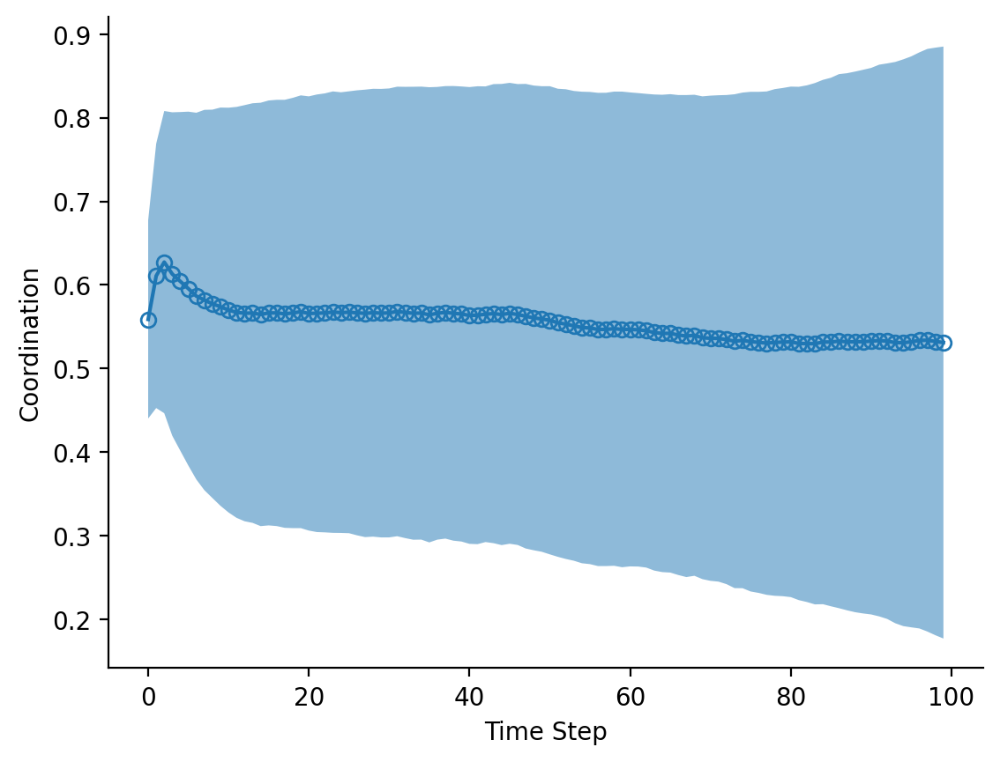

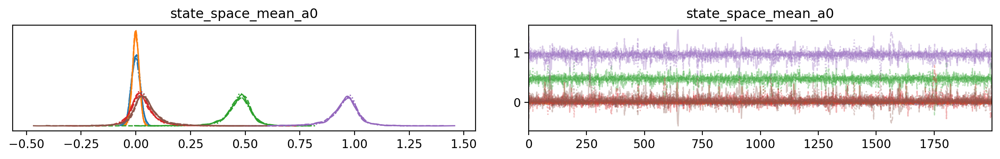

In [31]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = None #"norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0] / 50
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
# bundle.sd_a = None
# bundle.sd_o = None
bundle.mean_a0 = None
# bundle.mean_uc0 = None
# bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 1008 seconds.


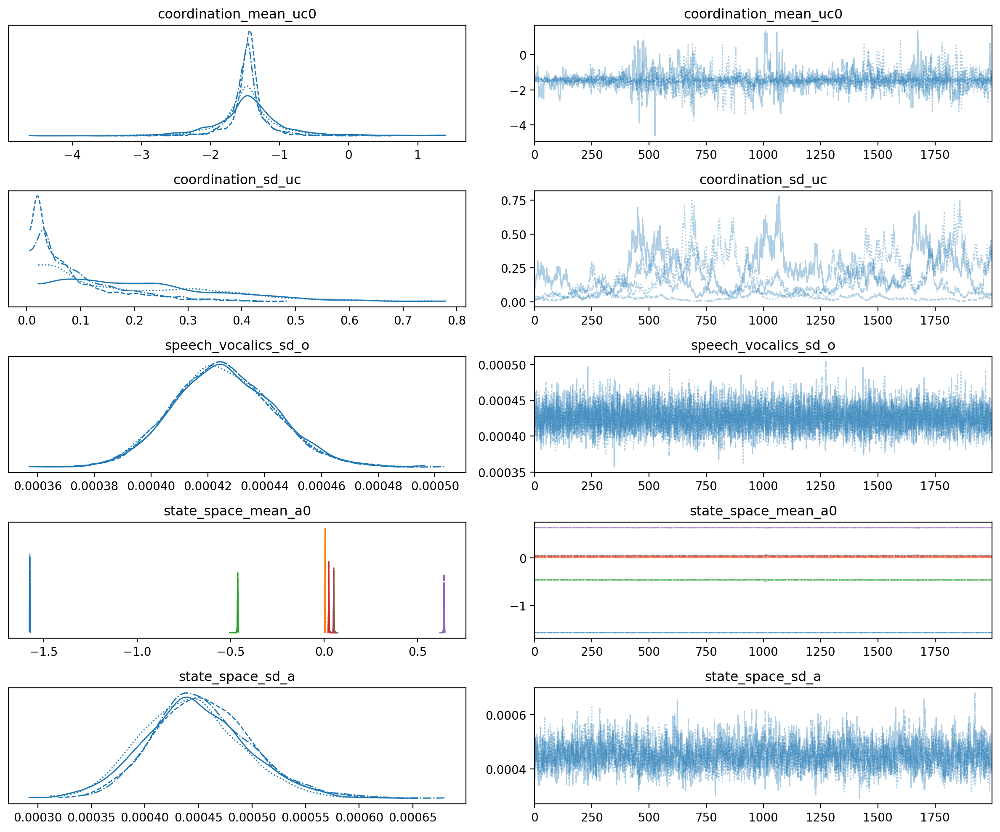

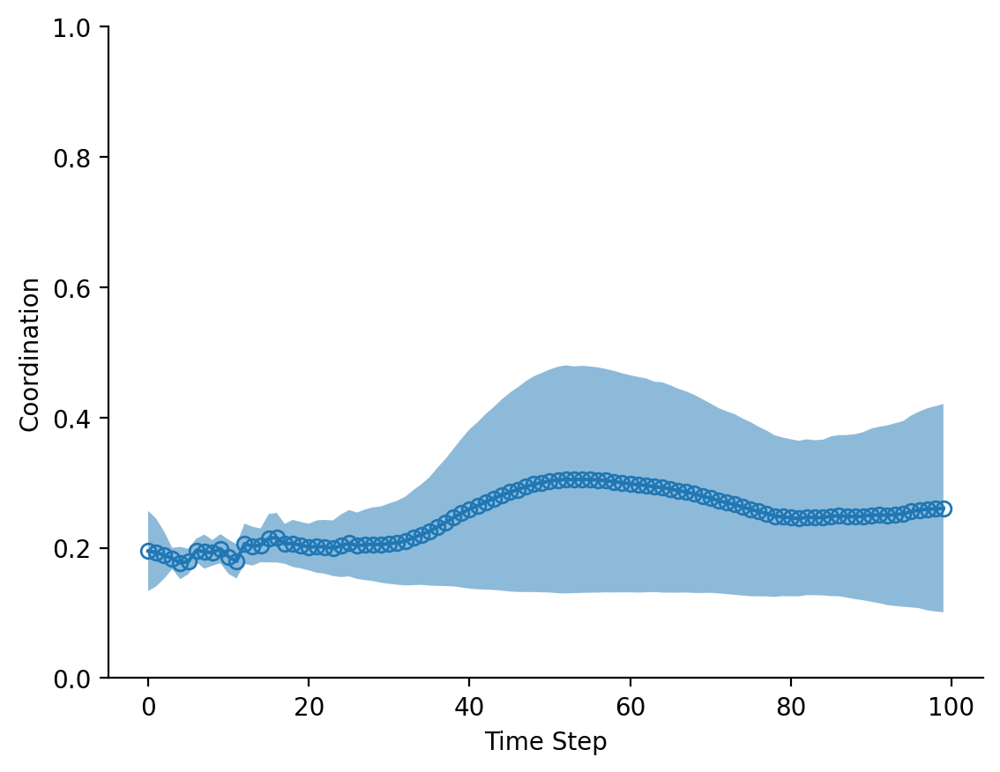

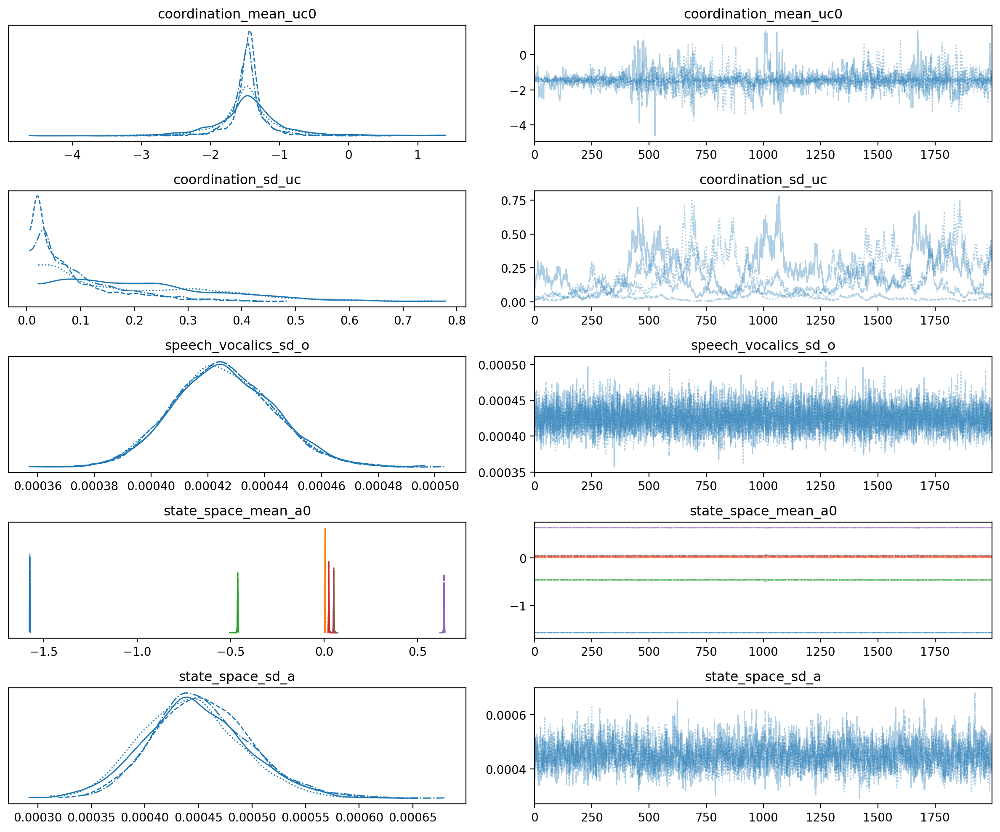

In [186]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit(burn_in=4000)
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

In [188]:
# bundle = deepcopy(template_bundle)
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])

bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None

model = VocalicModel(bundle)
model.prepare_for_sampling()
samples = template_model.draw_samples()
update_config_bundle_from_samples(model.config_bundle, samples)

# idata7 = train(model)

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 493 seconds.


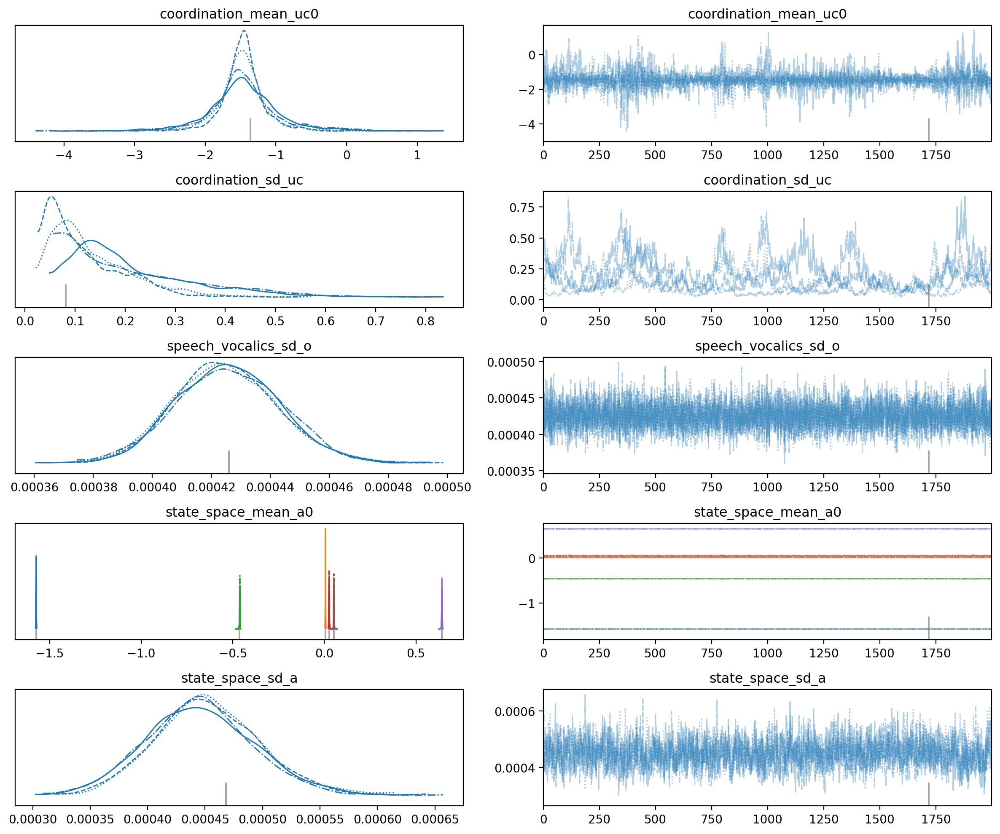

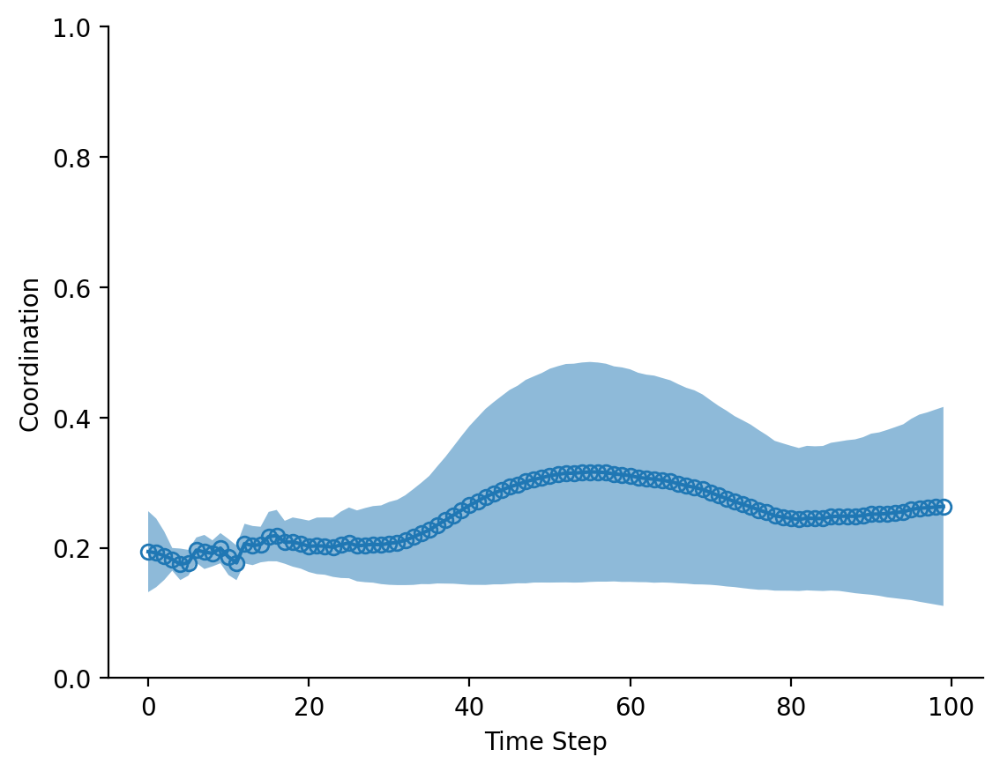

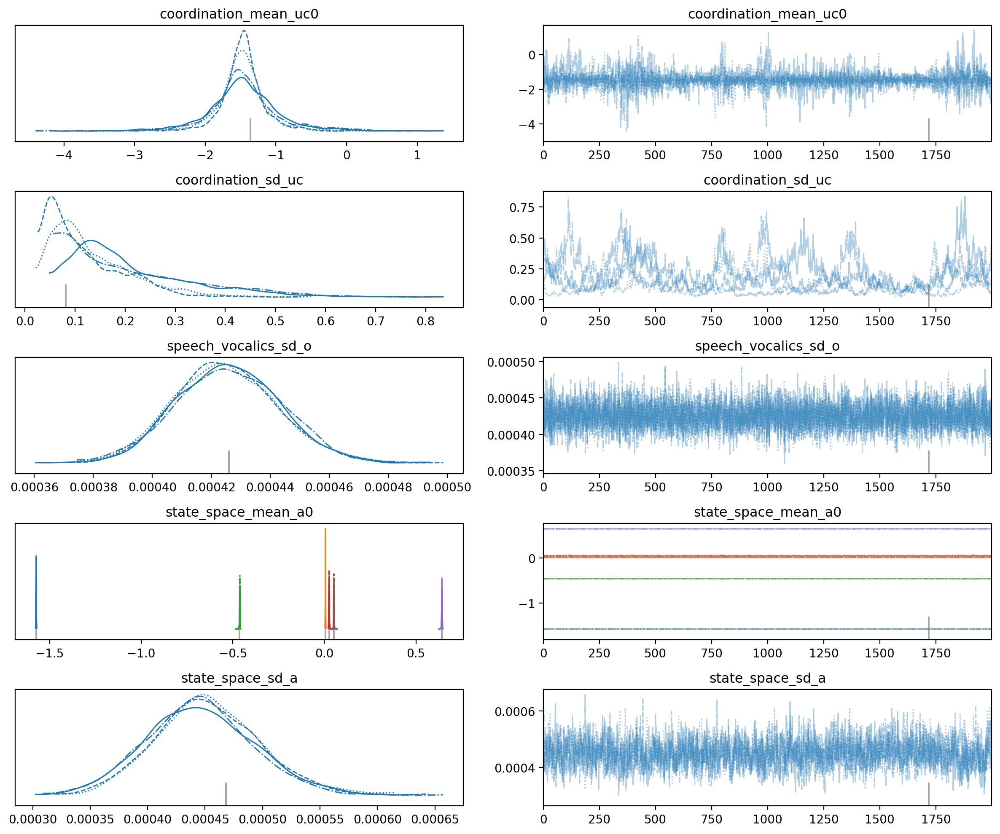

In [200]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = deepcopy(template_bundle)
# bundle.weights = [np.array([[1, 1, 1, 1]])] # different scale per feature
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata_tmp = model.fit()
idata_tmp.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata_tmp.plot_parameter_posterior()

Observations (speech_vocalics) will be normalized per feature.


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 560 seconds.


                 variable  mean_rhat  std_rhat
0   coordination_mean_uc0   1.167499  0.000000
1  unbounded_coordination   1.126550  0.031097
2     state_space_mean_a0   1.030256  0.022069
3             state_space   1.001625  0.004579
4      coordination_sd_uc   1.520559  0.000000
5        state_space_sd_a   1.024418  0.000000
6    speech_vocalics_sd_o   0.999848  0.000000
7            coordination   1.126139  0.030818


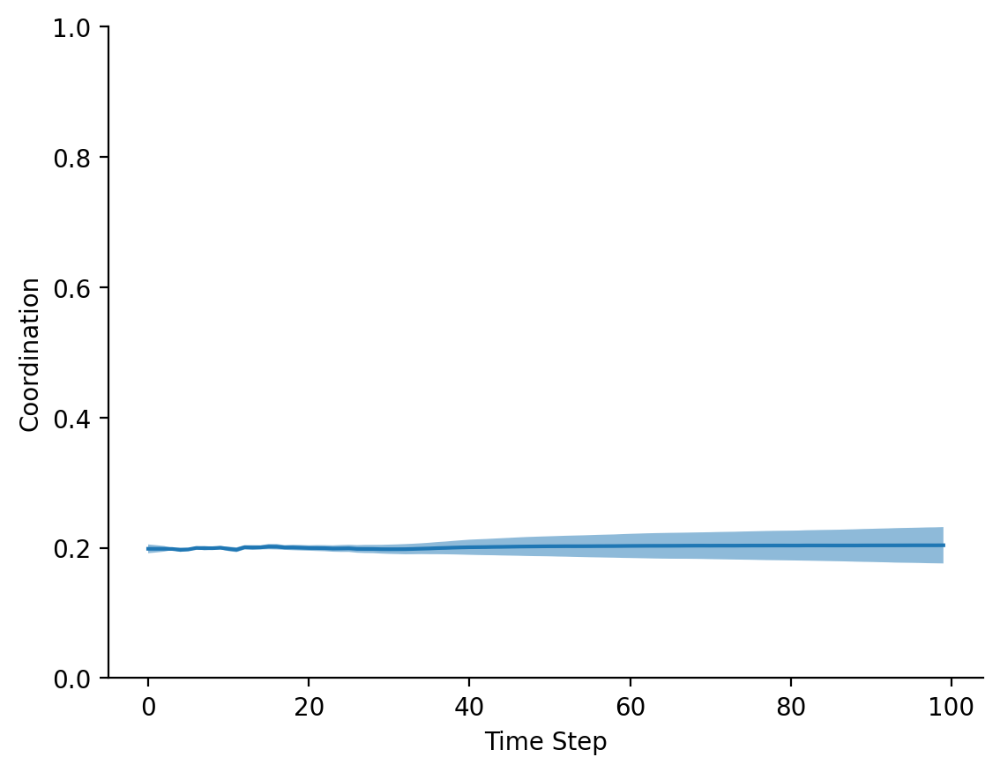

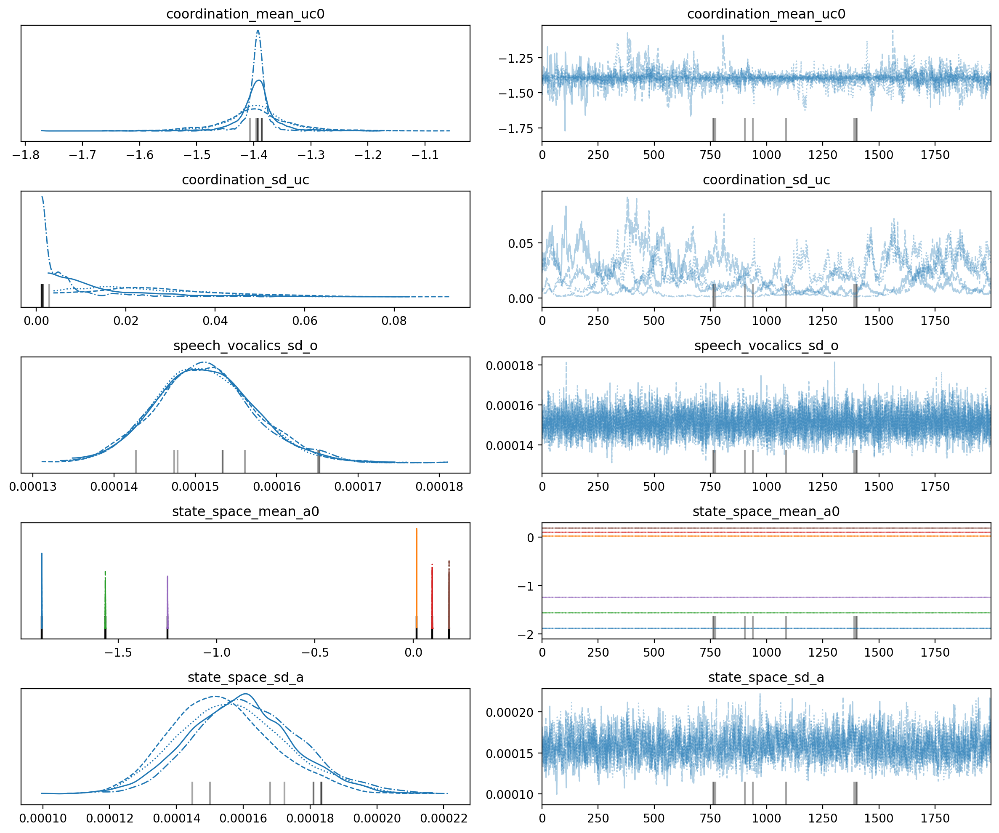

In [210]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
bundle.mean_a0 = np.array([[0,1], [25,5], [50,10]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)

model = VocalicModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()
update_config_bundle_from_samples(model.config_bundle, samples)

bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None

train(model)